**Course**: Time Series Analysis for Environmental Sciences

**Name**: Yehuda Yungstein

**ID**: 205487143

---
# Introduction

This study delves into the intricate dynamics of the Hula Lake ecosystem in Israel (N 33° 6.200040 E 35° 36.380760), employing a comprehensive analysis of meteorological and remote sensing data. The overarching goal is to elucidate the environmental impacts of water and vegetation factors within this unique lacustrine environment, with a particular emphasis on describing the changes between the lake and the vegetation affecting the energy balance and carbon emissions.

Wetlands contain a disproportionate amount of the earth’s total soil carbon; holding between 20 and 30% of the estimated 1,500 Pg of global soil carbon despite occupying 5–8% of its land surface [[Nahlik and Fennessy., 2016](https://www.nature.com/articles/ncomms13835)], underscoring the necessity to isolate and monitor the various factors within these ecosystems. This project aims to achieve an initial understanding of the differences in the annual and daily ranges of various parameters between the water station and the vegetation station, paving the way for future forecasting and linking remote sensing data to physical parameters.

## Data Acquisition

The dataset comprises in-situ measurements obtained from two strategically positioned meteorological stations: one situated on the lake's water surface and the other on a vegetated island within the lake (Fig 1). These stations meticulously recorded a myriad of atmospheric and hydrological parameters, including:

- Temperature
- Relative humidity
- Wind speed and direction
- Energy balance components
- Water fluxes
- Carbon dioxide levels
- Evaporation
- Precipitation

Additionally, remotely sensed data from the Sentinel-2 satellite was acquired, spanning the period from 2017 to 2024, with a temporal resolution of 5 days and a spatial resolution of 10 meters.

![alt text](Stations_Image.png)

**Figure 1** - Map of the Hula Lake ecosystem, depicting the locations of the water and vegetation meteorological stations.

## Analysis Approach

The analysis is divided into two distinct phases: near-term and long-term.

### Near-Term Analysis

The near-term analysis focuses on the high-frequency meteorological data collected from October 23, 2023, to February 24, 2024, encompassing approximately 9 months. The dataset consists of 12,000 rows and 25 columns, with measurements sampled at a half-hourly temporal resolution.

The analysis will proceed as follows:

1. **Data Preprocessing**: Implement cleaning procedures to handle noise and missing data (date formating, outliers, filling gaps etc.).
2. **Daily Trend Comparison**: Compare daily trends in recorded parameters between the two stations to discern potential micro-environmental differences.
3. **Cross-Correlation Analysis**: Employ cross-correlation analysis on the daily trends to quantify time differences.

### Long-Term Analysis

For the long-term analysis, remotely sensed data from the Sentinel-2 satellite will be utilized, resulting in approximately 300 samples of average NDVI (Normalized Difference Vegetation Index) values for the lake water and vegetated island.

The analysis will involve the following steps:

1. **Time Series Generation**: Generate time series of average NDVI values for the lake water and vegetated island.
2. **Smoothing and Resampling**: Perform smoothing and resampling procedures on the time series data.
3. **Decomposition**: Decompose the time series into trend and cyclical components.
4. **Trend Observation**: Observe and compare annual trends in vegetation dynamics between the lake and the island.
5. **tationarity Test**: Conduct stationarity tests on the time series data.
6. **ACF and PACF**: Analyze the autocorrelation and partial autocorrelation functions of the time series data.
7. **ARIMA Modeling**: Implement ARIMA modeling as forecasting tool.

Throughout the analysis, I will adhere to rigorous scientific standards, employing appropriate statistical techniques and data visualization methods to effectively communicate our findings.

# Import Libraries

In [12]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_theme(style="white",font_scale = 1.2)
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['axes.linewidth'] = 1.5
import matplotlib.dates as mdates
import plotly.graph_objects as go
from plotly.subplots import make_subplots
import os
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import RandomizedSearchCV
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from scipy.signal import correlate
# import decompose from statsmodels
from statsmodels.tsa.seasonal import seasonal_decompose
import joblib
from scipy.signal import savgol_filter
import scipy.stats as stats
import scipy.fft 
from scipy.signal import find_peaks
from statsmodels.tsa.stattools import adfuller
from statsmodels.graphics.tsaplots import plot_pacf, plot_acf
from statsmodels.tsa.arima.model import ARIMA
# Apply widget in matplotlib
#%matplotlib widget

# palette for the plots
color_palette = [
    "#E69F00", # Vivid Yellow
    "#56B4E9", # Sky Blue
    "#009E73", # Sap Green
    "#F0E442", # Lemon Yellow
    "#0072B2", # Navy Blue
    "#D55E00", # Vermillion
    "#CC79A7", # Plum
    "#006D2C", # Bottle Green
    "#FFB6C1", # Light Pink
    "#00B0F0", # Electric Blue
    "#E06633", # Burnt Orange
    "#7FB3D5", # Aero Blue
    "#D81E5B", # Raspberry
    "#8DD3C7"  # Mint Green
]

# Near-Term Analysis

## Importing the Data

In [13]:
# define path
path_water = 'Water_ec.csv'
path_veg = 'Veg_ec.csv'

# read the files into dataframes
water_df = pd.read_csv(path_water)
veg_df = pd.read_csv(path_veg).drop(columns = ['time'])

In [14]:
water_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 13895 entries, 0 to 13894
Data columns (total 25 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   time            13895 non-null  object 
 1   Tau             13730 non-null  float64
 2   H               9399 non-null   float64
 3   LE              13092 non-null  float64
 4   co2_flux        7210 non-null   float64
 5   ET              11605 non-null  float64
 6   max_wind_speed  13894 non-null  float64
 7   wind_dir        13894 non-null  float64
 8   SWTop           13607 non-null  float64
 9   SWBottom        13607 non-null  float64
 10  LWTop           13607 non-null  float64
 11  LWBottom        13607 non-null  float64
 12  Rs              13607 non-null  float64
 13  Rl              13607 non-null  float64
 14  Rn              13607 non-null  float64
 15  Ta              13460 non-null  float64
 16  RH              13467 non-null  float64
 17  Tw              13608 non-null 

In [15]:
veg_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12221 entries, 0 to 12220
Data columns (total 60 columns):
 #   Column                         Non-Null Count  Dtype  
---  ------                         --------------  -----  
 0   index                          3105 non-null   float64
 1   TIMESTAMP                      12221 non-null  object 
 2   RECORD                         12220 non-null  float64
 3   Batt_volt_Min                  12220 non-null  float64
 4   PTemp_C_Avg                    12220 non-null  float64
 5   Air                            12220 non-null  float64
 6   RH_LoggerNet                   12220 non-null  float64
 7   SW_Up_Avg                      12220 non-null  float64
 8   SW_Lo_Avg                      12220 non-null  float64
 9   LW_Up_Avg                      12220 non-null  float64
 10  LW_Lo_Avg                      12220 non-null  float64
 11  NET_Avg                        12220 non-null  float64
 12  Albedo_Avg                     12220 non-null 

## Data Cleaning

1. Create correct time column for the water station. 
2. Rename the columns of vegetation data to water station names.
3. Remove duplicates values.
4. Set time as datetime index.
5. Cut the data to the same time period
6. Adjust the time zone of water stations to the same time zone (winter and summer time)
7. sort the dataframes by time index.
8. Plot the data to visualize the time series.

1. Create correct time column for the water station.

In [16]:
# Define start and end dates
start_date = '2023-05-01 00:00:00'
end_date = '2024-02-14 11:00:00'

# Generate the series of dates with half-hour difference
date_series = pd.date_range(start=start_date, end=end_date, freq='30T')

# Print the generated date series
len(date_series),len(water_df)

# replace the date column in water station with the generated date series
water_df['time'] = date_series

In [17]:
# 2. rename the columns of the vegestation dataframe
def rename_columns(df):
    """
    Rename the vegestation columns to match the water station columns names
    """
    columns_dict = {
        'TIMESTAMP': 'time',
        'SW_Up_Avg': 'SWTop',
        'SW_Lo_Avg': 'SWBottom',
        'LW_Up_Avg': 'LWTop',
        'LW_Lo_Avg': 'LWBottom',
        'NET_Avg': 'Rn',
        'Albedo_Avg': 'albedo',
        'air_temperature': 'Ta',
        'RH_Licor': 'RH',
        'wind_speed': 'ws',
    }
    df = df.rename(columns=columns_dict)
    return df

# Function to remove duplicates
def remove_duplicates(df):
    df = df.drop_duplicates(subset='time')
    return df

# Function to convert the time to datetime
def convert_time(df):
    df['time'] = pd.to_datetime(df['time'])
    return df

# Function to set the time as the index
def set_index(df):
    df = df.set_index('time')
    return df

# Function to cut the long df to match the shorter df
def cut_df(df1, df2):
    """
    Cut the longer dataframe to match the length of the shorter dataframe based on the index
    """
    # Find the latest date among the first dates of each DataFrame
    latest_start_date = max(df1.index.min(), df2.index.min())
    
    # Find the earliest date among the last dates of each DataFrame
    earliest_end_date = min(df1.index.max(), df2.index.max())
    
    # Cut DataFrames to be between the latest start date and earliest end date
    df1 = df1.loc[(df1.index >= latest_start_date) & (df1.index <= earliest_end_date)]
    df2 = df2.loc[(df2.index >= latest_start_date) & (df2.index <= earliest_end_date)]
    
    return df1, df2

# Function to start the df from specific date
def start_from(df, date):
    df = df.loc[df.index >= date]
    return df

def adjust_hour_by_season(df, winter_summer_dates):
    """
    Correction of water station clock deviation with a difference of 1 hour in summer
    based on winter and summer dates clock change.
    input: df
    output: df after correction based on date
    """

    def adjust_time(row):
        year = row['time'].year
        winter_date = pd.to_datetime(winter_summer_dates[year][0])
        summer_date = pd.to_datetime(winter_summer_dates[year][1])

        if winter_date <= row['time'] < summer_date:
            row['time'] += pd.DateOffset(hours=0)
        else:
            row['time'] += pd.DateOffset(hours=1)

        return row

    df = df.apply(adjust_time, axis=1)

    return df

In [18]:
# Use the functions to clean the dataframes

# Vegestation data
veg_df = rename_columns(veg_df)
veg_df = remove_duplicates(veg_df)
veg_df = convert_time(veg_df)
veg_df = set_index(veg_df)

# Water data
water_df = remove_duplicates(water_df)

# Define dates for winter and summer time
winter_summer_dates = {2022: ('2022-10-30 02:00:00', '2023-03-24 03:00:00'),
                       2023: ('2023-10-29 02:00:00', '2024-03-25 03:00:00'),
                       2024: ('2024-10-27 02:00:00', '2025-03-30 03:00:00'),
                       2025: ('2025-10-26 02:00:00', '2026-03-27 03:00:00')}

water_df = adjust_hour_by_season(water_df, winter_summer_dates)
water_df = set_index(water_df)
water_df, veg_df = cut_df(water_df, veg_df)

# Start the dataframes from the same date (after the gap of 05-23)
start_date = "2023-05-17 10:00:00"
water_df = start_from(water_df, start_date)
veg_df = start_from(veg_df, start_date)


# print the start and end dates of the dataframes
print(veg_df.index.min(), veg_df.index.max())
print(water_df.index.min(), water_df.index.max())

# sort the dataframes by time index
veg_df = veg_df.sort_index()
water_df = water_df.sort_index()

2023-05-17 10:00:00 2024-01-28 13:30:00
2023-05-17 10:00:00 2024-01-28 13:30:00


9. Plot the data to visualize the time series.

array([<AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>],
      dtype=object)

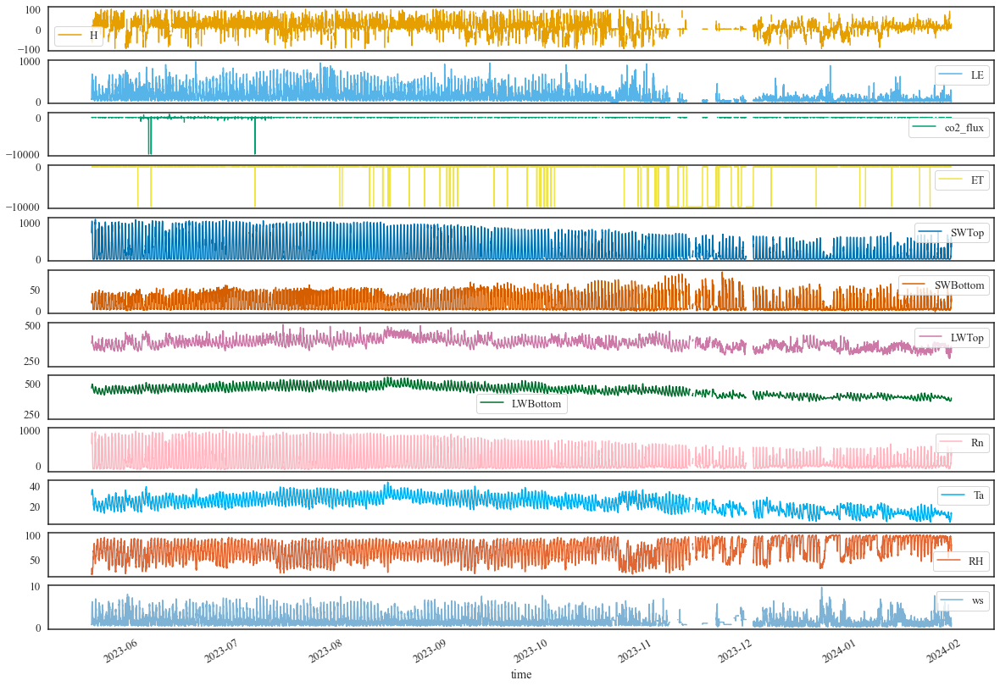

In [19]:
cols_to_plot = ['H', 'LE', 'co2_flux', 'ET', 'SWTop', 'SWBottom', 'LWTop', 'LWBottom', 'Rn', 'Ta', 'RH', 'ws']
water_df[cols_to_plot].plot( figsize=(20, 15), sharex=True, subplots=True, color = color_palette)

array([<AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>,
       <AxesSubplot:xlabel='time'>, <AxesSubplot:xlabel='time'>],
      dtype=object)

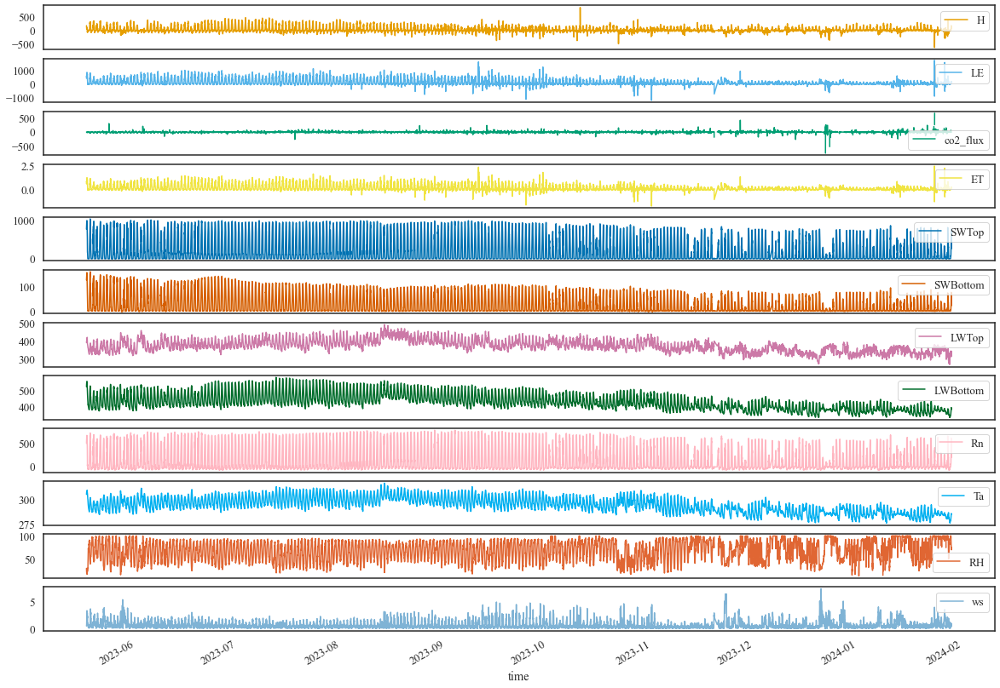

In [20]:
veg_df[cols_to_plot].plot( figsize=(20, 15), sharex=True, subplots=True, color = color_palette)

### **Remove outliers**
1. replace qc = 2 with NaN (qc is the quality control column in the vegetation station. 2 means bad data. Water station allready have NaN values for bad data)
1. replace values of -9999 with NaN
2. Convert the temperature from Kelvin to Celsius in vegetation station data.
3. Convert LE > 1000 to NaN
4. Convert ET > 2 to NaN
5. Convert co2_flux < -150 or > 150 to NaN
6. Convert H < -300 to NaN
8. remove total nan rows
9. Keep only the parameters (columns) that are in both dataframes.

In [21]:
# Function for clean veg data from qc = 2
def clean_veg_data(df):
    ''''Function to replace every value in value columns with NaN if the corresponding value in qc columns is 2'''

    # define the value and qc columns
    value_columns = ['H', 'LE', 'co2_flux', 'h2o_flux', 'Tau']
    qc_columns = ['qc_' + col for col in value_columns]

    # replace the values with NaN
    for value, qc in zip(value_columns, qc_columns):
        if value in df.columns:
            df[value] = np.where(df[qc] == 2, np.nan, df[value])
    return df  

def convert_temp(df):
    df['Ta'] = df['Ta'] - 273.15
    return df 

# clean the veg data
veg_df = clean_veg_data(veg_df)
veg_df = convert_temp(veg_df)

In [22]:
def replace_9999(df):
    """
    Replace the 9999 values with NaN
    """
    df = df.replace(-9999, np.nan)
    return df

# Convert LE <0 or > 1000 to NaN
def replace_LE(df):
    df['LE'] = np.where((df['LE'] < 0) | (df['LE'] > 1000), np.nan, df['LE'])
    return df

# Convert ET <0 or > 2 to NaN
def replace_ET(df):
    df['ET'] = np.where((df['ET'] < 0) | (df['ET'] > 2), np.nan, df['ET'])
    return df

# Convert co2_flux < -200 or > 200 to NaN
def replace_co2_flux(df):
    df['co2_flux'] = np.where((df['co2_flux'] < -150) | (df['co2_flux'] > 150), np.nan, df['co2_flux'])
    return df

# Convert H < -300 to NaN
def replace_H(df):
    df['H'] = np.where((df['H'] < -300), np.nan, df['H'])
    return df

# Remove total nan rows
def remove_nan_rows(df):
    '''Drop rows with all NaN values'''
    df = df.dropna(how='all')
    return df

In [23]:
# apply the functions to the dataframes
veg_df = replace_9999(veg_df)
veg_df = replace_LE(veg_df)
veg_df = replace_ET(veg_df)
veg_df = replace_co2_flux(veg_df)
veg_df = replace_H(veg_df)
veg_df = remove_nan_rows(veg_df)

# water data
water_df = replace_9999(water_df)
water_df = replace_LE(water_df)
water_df = replace_ET(water_df)
water_df = replace_co2_flux(water_df)
water_df = replace_H(water_df)
water_df = remove_nan_rows(water_df)

In [24]:
# Keep the columns that are common in both dataframes
common_columns = water_df.columns.intersection(veg_df.columns)
water_df = water_df[common_columns]
veg_df = veg_df[common_columns]

### Filling Gaps

First, let's check the missing values in the main parameters of the data.

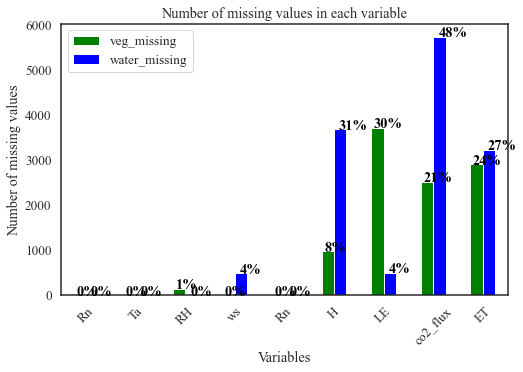

,veg_missing,water_missing
Rn,1,9
Ta,0,8
RH,153,8
ws,0,498
Rn,1,9
H,985,3686
LE,3714,503
co2_flux,2524,5737
ET,2907,3228


In [25]:
columns = ['Rn', 'Ta', 'RH', 'ws', 'Rn', 'H', 'LE', 'co2_flux', 'ET']

# count the number of missing values in each column in each dataframe and create df
veg_missing = veg_df[columns].isna().sum()
water_missing = water_df[columns].isna().sum()

# create a df to compare the missing values in the 2 dataframes
missing_df = pd.concat([veg_missing, water_missing], axis=1)
missing_df.columns = ['veg_missing', 'water_missing']

# plot the missing values
fig, ax = plt.subplots(figsize=(8, 5))
# plot the bar chart while veg is green and water is blue
missing_df.plot(kind='bar', ax=ax, color = ['green', 'blue'])
# Add the precetage of missing values as text on the bars for each variable and each dataframe
for i, (veg, water) in enumerate(zip(veg_missing, water_missing)):
    ax.text(i-0.2, veg, f'{veg/len(veg_df)*100:.0f}%', color='black', fontweight='bold')
    ax.text(i+0.1, water, f'{water/len(water_df)*100:.0f}%', color='black', fontweight='bold')
ax.set_ylabel('Number of missing values')
ax.set_xlabel('Variables')
ax.set_title('Number of missing values in each variable')
plt.xticks(rotation=45)
plt.show()

# Show the missing values in the dataframes
missing_df

I will implement a comprehensive strategy for filling missing data points. This approach suggested by the paper "*Eddy Covariance CO2 Flux Gap Filling for Long Data Gaps: A Novel Framework Based on Machine Learning and Time Series Decomposition*" by Gao et al. [[Link](https://www.mdpi.com/2072-4292/15/10/2695)].

The process involves the following steps:

1. **Identify Consecutive Missing Value Sequences**
  - I will analyze the time series data to identify sequences of consecutive missing values.
  - The number of consecutive missing values in each sequence will be counted.

2. **Apply Appropriate Filling Method**
  - Based on the count of consecutive missing values, I will employ different filling methods to impute the missing data points.
  - This approach ensures that the most suitable technique is applied, considering the length of the missing value sequence.

  - **For up to 3 consecutive missing values**
    - Linear interpolation will be used to fill these short gaps.
    - Linear interpolation estimates the missing values by drawing a straight line between the adjacent known data points.

  - **For 3 to 4 consecutive missing values**
    - Polynomial interpolation (quadratic) will be employed.
    - Polynomial interpolation fits a higher-order curve through the known data points, providing a more flexible estimate for the missing values.

  - **For up to 5 or more consecutive missing values (Only for CO<sub>2</sub> flux)**
    - I will implement the Random Forest (RF) and detrending approach proposed by Gao et al.
    - This method involves training a Random Forest model on the available data to predict the missing values.
    - Additionally, a detrending step is applied to remove any underlying trends or seasonal patterns before and after the gap. 

- **Fill the gaps in LE and ET based on linear regression.**
  - Find the correlation between the parameters and fill the gaps in the parameters based on the correlation (slope and intercept).



By tailoring the filling method to the length of the missing value sequence, I can leverage the strengths of each technique and ensure accurate and reliable imputations. The methodology proposed by Gao et al. specifically addresses longer gaps in the data, providing a robust solution for gaps of 5 or more consecutive missing values.

After applying the appropriate filling method, the resulting time series will have fewer gaps, enabling more accurate analysis, modeling, and interpretation of the data. 

⚠️ **Note**: The  *Gao et al* filling method will be applied only for CO<sub>2</sub> flux, in order to show the implementation of the method. For the rest of the parameters, I will not fill the gaps above 5 consecutive missing values.

In [26]:
# Reset index to ensure unique timestamps
veg_df.reset_index(inplace=True)
water_df.reset_index(inplace=True)

# Up to 2 consecutive missing values: fill with linear interpolation
veg_df = veg_df.interpolate(method='linear', limit=3)
water_df = water_df.interpolate(method='linear', limit=3)

# between 3 and 4 consecutive missing values: fill with polynomial interpolation
veg_df = veg_df.interpolate(method='polynomial', order=2, limit=4)
water_df = water_df.interpolate(method='polynomial', order=2, limit=4)

# Set the index back to the original index
veg_df = veg_df.set_index('time')
water_df = water_df.set_index('time')

Gao et.al. method:
1. drop NaN values
2. Add hour, day, month columns
3. Define Features:  Total Radiation, Temperature, Wind speed, Heat flux, Hour, DOY, Month.
4. Standardize the features by removing the mean and scaling to unit variance.
5. Split the data to train and test.
6. Train Random Forest model while input is the features and output is the CO2 flux. Tune hyperparameters using random search.
7. Predict the CO2 flux for the missing values using the trained model.
8. Decompose the filled CO2 flux to trend, seasonal and residual components.
9. Train new RF model to predict the trend component using the same features.
10. Using the trained model predict the trend component for the original missing values (the reason for this step is that the trend component is not well predicted by the first model and now I can predict it better).

In [27]:
# Separate the data into two parts: one with missing values for CO2 and the other without missing values
df_miss_co2 = veg_df[['Rn', 'Ta', 'ws', 'H', 'co2_flux']].dropna()

#  Add hour, day, month, and year columns to the dataframe
df_miss_co2['hour'] = df_miss_co2.index.hour
df_miss_co2['day'] = df_miss_co2.index.day
df_miss_co2['month'] = df_miss_co2.index.month

#  Define the features and the target variable
X = df_miss_co2[[ 'Rn', 'Ta', 'ws', 'H', 'hour', 'day', 'month',]]

# Normalize the features
#X = (X - X.mean()) / X.std()

# Define the target variable
y = df_miss_co2['co2_flux']

# Split the df_no_miss_co2 data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

Train the RF model:

⚠️ This step will take a few minutes to complete (27-40 minutes). I recommend to skip this step and load the trained model from the file *"best_rf_model.pkl"* in the next cell.

In [28]:
'''
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
                'max_features': max_features,
                'max_depth': max_depth,
                'min_samples_split': min_samples_split,
                'min_samples_leaf': min_samples_leaf,
                'bootstrap': bootstrap}

# Perform random search to find the best hyperparameters
rf = RandomForestRegressor(random_state=42)
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=random_grid, n_iter=50, cv=3, verbose=2, random_state=42, n_jobs=-1)
rf_random.fit(X_train, y_train)
# Train the random forest model on the training data with the best hyperparameters
best_rf = rf_random.best_estimator_
best_rf.fit(X_train, y_train)
'''

"\n# Number of trees in random forest\nn_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]\n# Number of features to consider at every split\nmax_features = ['auto', 'sqrt']\n# Maximum number of levels in tree\nmax_depth = [int(x) for x in np.linspace(10, 110, num=11)]\nmax_depth.append(None)\n# Minimum number of samples required to split a node\nmin_samples_split = [2, 5, 10]\n# Minimum number of samples required at each leaf node\nmin_samples_leaf = [1, 2, 4]\n# Method of selecting samples for training each tree\nbootstrap = [True, False]\n# Create the random grid\nrandom_grid = {'n_estimators': n_estimators,\n                'max_features': max_features,\n                'max_depth': max_depth,\n                'min_samples_split': min_samples_split,\n                'min_samples_leaf': min_samples_leaf,\n                'bootstrap': bootstrap}\n\n# Perform random search to find the best hyperparameters\nrf = RandomForestRegressor(random_state=42)\nrf_random = 

In [29]:
# Save the model
path = "best_rf_model.pkl"
#joblib.dump(best_rf,path)

# Load the model
best_rf = joblib.load(path)

Mean Absolute Error (MAE): 5.1353258416127385
Mean Squared Error (MSE): 95.00320942520068
R-squared Score: 0.7057579977387803


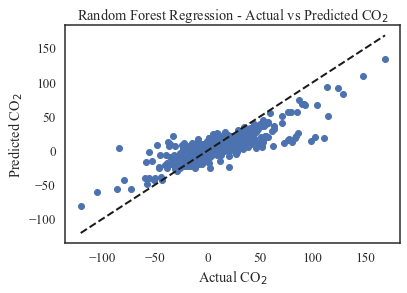

In [30]:
# Predict the CO2 values for the testing data using the trained model
y_pred = best_rf.predict(X_test)

# Calculate metrics for model evaluation
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("R-squared Score:", r2)

# Plot the predicted CO2 values against the actual CO2 values for the testing data
plt.scatter(y_test, y_pred)
# add 1:1 line
plt.plot([y_test.min(), y_test.max()], [y_test.min(), y_test.max()], 'k--', lw=2)
plt.xlabel('Actual CO$_2$')
plt.ylabel('Predicted CO$_2$')
plt.title('Random Forest Regression - Actual vs Predicted CO$_2$')
plt.show()

It can be seen that the model has some success in predicting the CO2 flux values, with a relatively high R<sup>2</sup> score of 0.7. The model's performance can be further improved that why I will train a new model to predict the trend component of the CO2 flux. First lets predict the nan values using the trained model:

In [31]:
# predict the CO2 values for the missing data using the trained model
df_no_miss_co2 = veg_df[[ 'Rn', 'Ta', 'ws', 'H' ]].dropna()
df_no_miss_co2['month'] = df_no_miss_co2.index.month
df_no_miss_co2['day'] = df_no_miss_co2.index.day
df_no_miss_co2['hour'] = df_no_miss_co2.index.hour

# predict the CO2 values for the missing data using the trained model
pred_co2 = best_rf.predict(df_no_miss_co2)

# Create new column in the dataframe for the predicted CO2 values
veg_df['co2_flux_pred'] = veg_df['co2_flux']

# Replace the missing CO2 values with the predicted CO2 values
veg_df['co2_flux_pred'] = veg_df['co2_flux_pred'].fillna(pd.Series(pred_co2, index=df_no_miss_co2.index))

Now I will decompose the filled CO2 flux to trend, seasonal and residual components and train a new RF model to predict the trend component using the same features. I will set the period of the seasonal component to 48 (one day) because the data is sampled every 30 minutes.

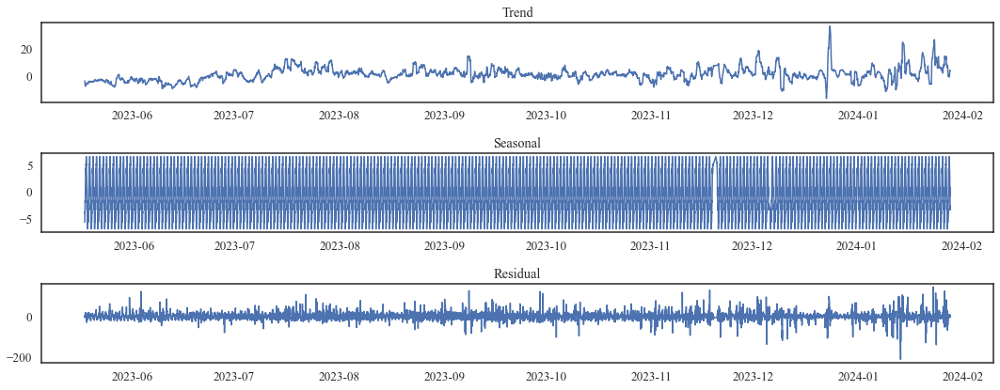

In [32]:
# Convert the CO2 data to a numpy array
co2_data = np.array(veg_df['co2_flux_pred'])

# Decompose the CO2 data into trend and fluctuation terms
result = seasonal_decompose(co2_data, model='additive', period=48)

# Plot the trend and fluctuation terms
plt.figure(figsize=(15, 6))
plt.subplot(311)
plt.plot(veg_df.index,result.trend)
plt.title('Trend')
plt.subplot(312)
plt.plot(veg_df.index,result.seasonal)
plt.title('Seasonal')
plt.subplot(313)
plt.plot(veg_df.index,result.resid)
plt.title('Residual')
plt.tight_layout()
plt.show()

In [33]:
# create component of trend + seasonal
trend_seasonal = result.trend + result.seasonal
veg_df['trend_seasonal'] = trend_seasonal
# Remove the data in the trend term where the original CO2 data is missing, keeping the fluctuation term intact.
veg_df['trend_seasonal'] = veg_df['trend_seasonal'].where(veg_df['co2_flux_pred'].notna())


veg_df['month'] = veg_df.index.month
veg_df['day'] = veg_df.index.day
veg_df['hour'] = veg_df.index.hour

# Use a second-layer machine learning model (RF, XGBoost, SVR, or BP neural network) with the meteorological/environmental inputs and the extracted trend term of NEE to predict and fill the gaps in the trend term.
x = veg_df[['Rn', 'Ta', 'ws', 'H','trend_seasonal', 'month', 'day', 'hour']].copy().dropna()
y= x['trend_seasonal']
x = x.drop(columns = ['trend_seasonal'])

# Normalize the features 
x = (x - x.mean()) / x.std()


# Split the data into training and testing sets
x_train, x_test, y_train, y_test = train_test_split(x, y, test_size=0.1, random_state=42)
x_train.shape, x_test.shape, y_train.shape, y_test.shape

((10917, 7), (1214, 7), (10917,), (1214,))

Train the RF model:

⚠️ This step will take a few minutes to complete (27-40 minutes). I recommend to skip this step and load the trained model from the file *"best_rf_model_trend.pkl"* in the next cell.

In [34]:
'''
# Number of trees in random forest
n_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]
# Number of features to consider at every split
max_features = ['auto', 'sqrt']
# Maximum number of levels in tree
max_depth = [int(x) for x in np.linspace(10, 110, num=11)]
max_depth.append(None)
# Minimum number of samples required to split a node
min_samples_split = [2, 5, 10]
# Minimum number of samples required at each leaf node
min_samples_leaf = [1, 2, 4]
# Method of selecting samples for training each tree
bootstrap = [True, False]
# Create the random grid
random_grid = {'n_estimators': n_estimators,
                'max_features': max_features,
                'max_depth': max_depth,
                'min_samples_split': min_samples_split,
                'min_samples_leaf': min_samples_leaf,
                'bootstrap': bootstrap}

# Perform random search to find the best hyperparameters
rf = RandomForestRegressor(random_state=42)
rf_random = RandomizedSearchCV(estimator=rf, param_distributions=random_grid, n_iter=50, cv=3, verbose=2, random_state=42, n_jobs=-1)
rf_random.fit(x_train, y_train)
# Train the random forest model on the training data with the best hyperparameters
best_rf = rf_random.best_estimator_
best_rf.fit(x_train, y_train)

# Predict the CO2 values for the testing data using the trained model
y_pred = best_rf.predict(x_test)

# Calculate metrics for model evaluation
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
r2 = r2_score(y_test, y_pred)

# Print the metrics
print("Mean Absolute Error (MAE):", mae)
print("Mean Squared Error (MSE):", mse)
print("R-squared Score:", r2)
'''

'\n# Number of trees in random forest\nn_estimators = [int(x) for x in np.linspace(start=200, stop=2000, num=10)]\n# Number of features to consider at every split\nmax_features = [\'auto\', \'sqrt\']\n# Maximum number of levels in tree\nmax_depth = [int(x) for x in np.linspace(10, 110, num=11)]\nmax_depth.append(None)\n# Minimum number of samples required to split a node\nmin_samples_split = [2, 5, 10]\n# Minimum number of samples required at each leaf node\nmin_samples_leaf = [1, 2, 4]\n# Method of selecting samples for training each tree\nbootstrap = [True, False]\n# Create the random grid\nrandom_grid = {\'n_estimators\': n_estimators,\n                \'max_features\': max_features,\n                \'max_depth\': max_depth,\n                \'min_samples_split\': min_samples_split,\n                \'min_samples_leaf\': min_samples_leaf,\n                \'bootstrap\': bootstrap}\n\n# Perform random search to find the best hyperparameters\nrf = RandomForestRegressor(random_state=4

As it can be seen the model has a high R<sup>2</sup> score of 0.87, 0.5 higher than the first model. The assumption is that the trend + seasonal components are better predicted by the new model, which make sense...

In [35]:
# Save the model
path = "best_rf_model_trend.pkl"
#joblib.dump(best_rf,path)

# Load the model
best_rf_trend = joblib.load(path)

In [36]:
# Use the model to predict the trend term for the missing data
x_missing = veg_df[['Rn', 'Ta', 'ws', 'H', 'month', 'day', 'hour']].copy().dropna()
x_missing = (x_missing - x.mean()) / x.std()
trend_missing = best_rf_trend.predict(x_missing)

# Create new column in the dataframe for the predicted trend term
veg_df['trend_missing'] = veg_df['trend_seasonal']

# Replace the missing trend term values with the predicted trend term values
veg_df['trend_missing'] = veg_df['trend_missing'].fillna(pd.Series(trend_missing, index=x_missing.index))

# replace nan in result.resid with 0
res_df = pd.DataFrame(result.resid, index = veg_df.index)
res_df = res_df.fillna(0)

# add the residual term to the trend term to get the final co2_filled
veg_df['co2_filled'] = veg_df['trend_missing'] + res_df[0]

# plot the filled co2 data as time series in plotly
fig = make_subplots(rows=1, cols=1)
fig.add_trace(go.Scatter(x=veg_df.index, y=veg_df['co2_filled'], mode='lines', name='Filled CO2'), row=1, col=1)
# add the original co2 data in differnt color
fig.add_trace(go.Scatter(x=veg_df.index, y=veg_df['co2_flux'], mode='lines', name='Original CO2'), row=1, col=1)
fig.update_layout(title='Filled CO2 data', xaxis_title='Time', yaxis_title='CO2')
fig.show()

As it can be seen now the maximum gap is 5% of the data in LE that reduced from 30% before the filling.

**Fill the gaps in LE and ET based on linear regression.**

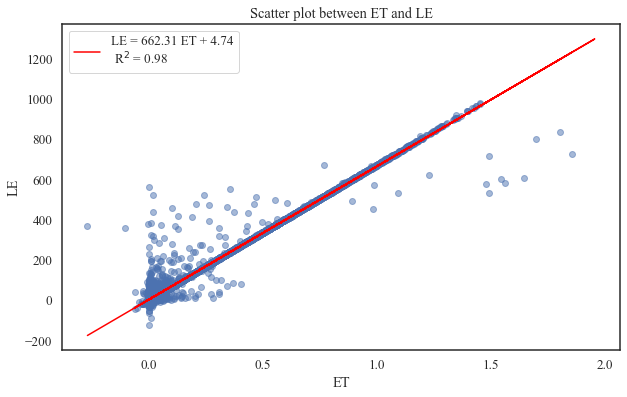

In [37]:
# plot the scatter between ET and LE
fig, ax = plt.subplots(figsize=(10, 6))
ax.scatter(veg_df.dropna()['ET'], veg_df.dropna()['LE'], alpha=0.5)
# Add equation of the line
slope, intercept, r_value, p_value, std_err = stats.linregress(veg_df.dropna()['ET'], veg_df.dropna()['LE'])
line = f'LE = {slope:.2f} ET + {intercept:.2f}\n R$^2$ = {r_value**2:.2f}'
ax.plot(veg_df['ET'], slope*veg_df['ET'] + intercept, color='red', label=line)
ax.set_xlabel('ET')
ax.set_ylabel('LE')
ax.set_title('Scatter plot between ET and LE')
ax.legend()
plt.show()


# Fill the missing values in the LE column using the linear regression equation
veg_df['LE'] = veg_df['LE'].fillna(veg_df['ET'] * slope + intercept)

# Same for water data
# plot the scatter between ET and LE
slope, intercept, r_value, p_value, std_err = stats.linregress(water_df.dropna()['ET'], water_df.dropna()['LE'])
water_df['LE'] = water_df['LE'].fillna(water_df['ET'] * slope + intercept)


# Fill the missing values in the ET column using the linear regression equation
veg_df['ET'] = veg_df['ET'].fillna((veg_df['LE'] - intercept) / slope)

# Same for water data
water_df['ET'] = water_df['ET'].fillna((water_df['LE'] - intercept) / slope)

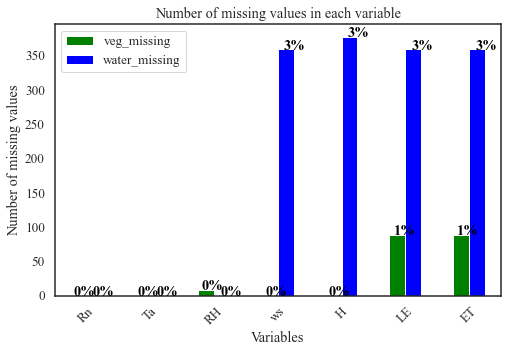

Total percentage of missing values in vegestation data: 0.13%
Total percentage of missing values in water station data: 1.91%


,veg_missing,water_missing
Rn,0,0
Ta,0,0
RH,9,0
ws,0,359
H,0,377
LE,89,359
ET,89,359


In [38]:
columns = ['Rn', 'Ta', 'RH', 'ws', 'H', 'LE', 'ET']

# count the number of missing values in each column in each dataframe and create df
veg_missing = veg_df[columns].isna().sum()
water_missing = water_df[columns].isna().sum()

# create a df to compare the missing values in the 2 dataframes
missing_df = pd.concat([veg_missing, water_missing], axis=1)
missing_df.columns = ['veg_missing', 'water_missing']

# plot the missing values
fig, ax = plt.subplots(figsize=(8, 5))
# plot the bar chart while veg is green and water is blue
missing_df.plot(kind='bar', ax=ax, color = ['green', 'blue'])
# Add the precetage of missing values as text on the bars for each variable and each dataframe
for i, (veg, water) in enumerate(zip(veg_missing, water_missing)):
    ax.text(i-0.2, veg, f'{veg/len(veg_df)*100:.0f}%', color='black', fontweight='bold')
    ax.text(i+0.1, water, f'{water/len(water_df)*100:.0f}%', color='black', fontweight='bold')
ax.set_ylabel('Number of missing values')
ax.set_xlabel('Variables')
ax.set_title('Number of missing values in each variable')
plt.xticks(rotation=45)
plt.show()

# print the total precetage of missing values in each dataframe
print(f"Total percentage of missing values in vegestation data: {veg_df.isna().sum().sum()/veg_df.size*100:.2f}%")
print(f"Total percentage of missing values in water station data: {water_df.isna().sum().sum()/water_df.size*100:.2f}%")


# Show the missing values in the dataframes
missing_df

Figure 2. Comparison of the missing values presentage in the water (blue) and vegetation (green) data before and after the filling process. The total percentage of missing values in vegetation and water data after gap filling is 0.13% and 1.91

#### Summary - Gaps Filling

After applying the comprehensive gap-filling strategy, the dataset now contains significantly fewer missing values, enhancing the quality and completeness of the time series data. The approach leveraged a combination of interpolation techniques, machine learning models, and linear regression to impute the missing values, ensuring that the data is suitable for subsequent analysis and modeling tasks.

For the rest of the parameters, I will not fill the gaps above 5 consecutive missing values (as mentioned before, the method of Gao et al. will be applied only for CO<sub>2</sub> flux to show the implementation of the method but it can be applied to other parameters as well. Here, for time saving, I will not apply it to the other parameters).

### Smoothing the Data

1. Apply a Savitzky-Golay filter to smooth the data.
2. Plot the smoothed data to visualize the time series.

In [39]:
def smooth_sg(df,df_type, column, window, poly_order, ):
    """
    Smooths a column in a DataFrame using the Savitzky-Golay filter and plots the original and smoothed data using Plotly.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame.
    df_type (str): The type of the dataframe (water or veg).
    column (str): The name of the column to be smoothed.
    window (int): The window size for the Savitzky-Golay filter.
    poly_order (int): The order of the polynomial used in the Savitzky-Golay filter.
    
    Returns:
    pandas.Series: The smoothed column.
    """
    # Apply the Savitzky-Golay filter to the column
    smoothed_column = savgol_filter(df[column], window, poly_order)
    
    # Create a Plotly figure with subplots
    fig = make_subplots(rows=1, cols=1)
    
    # Add the original data to the plot
    fig.add_trace(go.Scatter(x=df.index, y=df[column], mode='lines', name='Original', line=dict(color='black')), row=1, col=1)
    
    # Add the smoothed data to the plot
    # if it water df in name, add the smoothed data in blue
    if df_type == 'water':
        fig.add_trace(go.Scatter(x=df.index, y=smoothed_column, mode='lines', name='Smoothed', line=dict(color='blue')), row=1, col=1)
    # if it veg df in name, add the smoothed data in green
    else:
        fig.add_trace(go.Scatter(x=df.index, y=smoothed_column, mode='lines', name='Smoothed', line=dict(color='green')), row=1, col=1)

    
    # Set the title and axis labels
    fig.update_layout(title=f"Smoothed {column}", xaxis_title="Time", yaxis_title=column)
    
    # Display the plot
    fig.show()
    
    return pd.Series(smoothed_column, index=df.index, name=f"{column}")

In [40]:
# Smooth the co2 using the Savitzky-Golay filter
veg_df['co2_flux'] = smooth_sg(veg_df, 'veg', 'co2_filled', 17, 3)
water_df['co2_flux'] = smooth_sg(water_df, 'water', 'co2_flux', 17, 3)

In [41]:
# Smoothed the Rn data for both veg and water
veg_df['Rn'] = smooth_sg(veg_df,'veg', 'Rn',  17, 3)
water_df['Rn'] = smooth_sg(water_df, 'water', 'Rn',  17, 3)

# Smoothed the Ta data for both veg and water
veg_df['Ta'] = smooth_sg(veg_df, 'veg', 'Ta',  17, 3)
water_df['Ta'] = smooth_sg(water_df, 'water', 'Ta',  17, 3)


# Smoothed the RH data for both veg and water
veg_df['RH'] = smooth_sg(veg_df, 'veg', 'RH',  17, 3)
water_df['RH'] = smooth_sg(water_df, 'water', 'RH',  17, 3)

# Smoothed the ws data for both veg and water
veg_df['ws'] = smooth_sg(veg_df, 'veg', 'ws',  11, 2)
water_df['ws'] = smooth_sg(water_df, 'water', 'ws',  11, 2)

# Smoothed the LE data for both veg and water
veg_df['LE'] = smooth_sg(veg_df,'veg', 'LE',  11, 2)
water_df['LE'] = smooth_sg(water_df, 'water', 'LE',  11, 2)

# Smoothed the ET data for both veg and water
veg_df['ET'] = smooth_sg(veg_df,'veg', 'ET',  11, 2)
water_df['ET'] = smooth_sg(water_df, 'water' ,'ET',   11, 2)

# Smoothed the H data for both veg and water
veg_df['H'] = smooth_sg(veg_df,'veg', 'H',  17, 3)
#water_df['H_smoothed'] = smooth_sg(water_df, 'water', 'H',  17, 3)


### Add Soil / Water Heat Flux Based on Energy Balance Equation

After cleaning and filling the gaps in the data, I will calculate the soil heat flux (G) using the energy balance equation:

$$ G = R_n - H - LE $$

Where:
- $ R_n $ is the net radiation (W/m<sup>2</sup>)
- $ H $ is the sensible heat flux (W/m<sup>2</sup>)
- $ LE $ is the latent heat flux (W/m<sup>2</sup>)
- $ G $ is the soil heat flux (W/m<sup>2</sup>)

In [42]:
# Add G column to the water dataframe
water_df['G'] = water_df['Rn'] - water_df['LE'] - water_df['H']

# Add G column to the veg dataframe
veg_df['G'] = veg_df['Rn'] - veg_df['LE'] - veg_df['H']

### Daily Trends Plots

1. Plot the daily trends of the parameters for both stations.
2. Calculate Cross-Correlation function between the daily trends of the parameters for both stations.
3. Compare the time lag for the maximum correlation.

In [43]:
def plot_daily_trend(parameter,label, show_zero_line=False):
    # Filter data from 5 in the morning to 5 in the morning of the next day
    water_df_filtered = water_df.between_time('05:00', '04:59:59')
    veg_df_filtered = veg_df.between_time('05:00', '04:59:59')
    
    # Calculate the mean + std of the parameter for each hour of the day in water station
    water_mean_std = water_df_filtered.groupby(water_df_filtered.index.hour)[parameter].agg(['mean', 'std'])
    
    # Calculate the mean + std of the parameter for each hour of the day in vegetation station
    veg_mean_std = veg_df_filtered.groupby(veg_df_filtered.index.hour)[parameter].agg(['mean', 'std'])
    
    # Plot the daily trend
    fig, ax = plt.subplots(figsize=(10, 6))

    # Plot water station
    ax.plot(water_mean_std['mean'], label='Water Station', color='blue')
    ax.fill_between(water_mean_std.index, water_mean_std['mean'] - water_mean_std['std'], water_mean_std['mean'] + water_mean_std['std'], alpha=0.3, color='blue')

    # Plot vegetation station
    ax.plot(veg_mean_std['mean'], label='Vegetation Station', color='green')
    ax.fill_between(veg_mean_std.index, veg_mean_std['mean'] - veg_mean_std['std'], veg_mean_std['mean'] + veg_mean_std['std'], alpha=0.3, color='green')

    if show_zero_line:
        ax.axhline(0, color='black', linewidth=1)
    
    plt.xlabel('Hour of Day')
    plt.ylabel(f'{label}')
    plt.title(f'Daily Trend of {label} in Water and Vegetation Stations')

    plt.grid(True)
    # XTICKS EVERY 2 HOURS
    ax.set_xticks(np.arange(0, 24, 2))
    plt.legend()
    plt.show()

In [44]:
def find_lag(water_series, veg_series, freq):
    # Calculate cross-correlation
    correlation = np.correlate(water_series - water_series.mean(), veg_series - veg_series.mean(), mode='full')
    
    # Normalized cross-correlation
    correlation /= np.sqrt(np.dot(water_series - water_series.mean(), water_series - water_series.mean()) * np.dot(veg_series - veg_series.mean(), veg_series - veg_series.mean()))
    
    # Find the lag where absolute correlation is highest
    max_corr_idx = np.argmax(np.abs(correlation))
    lag = max_corr_idx - (len(water_series) - 1)
    lag_minutes = lag * freq
    
    return correlation, lag_minutes

def plot_daily_trend(parameter, label, show_zero_line=False):
    # Filter data from 5 in the morning to 5 in the morning of the next day
    water_df_filtered = water_df.between_time('05:00', '04:59:59')
    veg_df_filtered = veg_df.between_time('05:00', '04:59:59')

    # Calculate the mean + std of the parameter for each hour of the day in the water station
    water_mean_std = water_df_filtered.groupby(water_df_filtered.index.hour)[parameter].agg(['mean', 'std'])

    # Calculate the mean + std of the parameter for each hour of the day in vegetation station
    veg_mean_std = veg_df_filtered.groupby(veg_df_filtered.index.hour)[parameter].agg(['mean', 'std'])

    # Calculate cross-correlation and find lag
    water_mean = water_df_filtered.groupby(water_df_filtered.index.time)[parameter].mean()
    veg_mean = veg_df_filtered.groupby(veg_df_filtered.index.time)[parameter].mean()
    freq = 30  # minutes
    correlation, lag = find_lag(water_mean, veg_mean, freq)

    # Generate x-axis values (time intervals) for cross-correlation plot
    x_values = np.arange(-len(water_mean) + 1, len(veg_mean)) * freq

    # Create a figure with two subplots
    fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(16, 6))

    # Plot the daily trend
    ax1.plot(water_mean_std['mean'], label='Water Station', color='blue')
    ax1.fill_between(water_mean_std.index, water_mean_std['mean'] - water_mean_std['std'], water_mean_std['mean'] + water_mean_std['std'], alpha=0.3, color='blue')
    ax1.plot(veg_mean_std['mean'], label='Vegetation Station', color='green')
    ax1.fill_between(veg_mean_std.index, veg_mean_std['mean'] - veg_mean_std['std'], veg_mean_std['mean'] + veg_mean_std['std'], alpha=0.3, color='green')
    if show_zero_line:
        ax1.axhline(0, color='black', linewidth=1)
    ax1.set_xlabel('Hour of Day')
    ax1.set_ylabel(f'{label}')
    ax1.set_title(f'Daily Trend of {label} in Water and Vegetation Stations')
    ax1.grid(True)
    ax1.set_xticks(np.arange(0, 24, 2))
    ax1.legend()

    # Plot the cross-correlation
    ax2.plot(x_values, correlation, lw=2, color='black')
    ax2.set_title(f'Cross-correlation between Stations for {parameter}\n Lag = {lag} minutes')
    # add vertical line at lag
    ax2.axvline(lag, color='r', linestyle='--', lw=2, label=f'Lag = {lag} minutes')
    # add vertical line at 0
    ax2.axvline(0, color='black', lw=1)
    ax2.set_xlabel('Lag (minutes)')
    ax2.set_ylabel('Correlation coefficient')
    ax2.grid(True)

    return fig

    

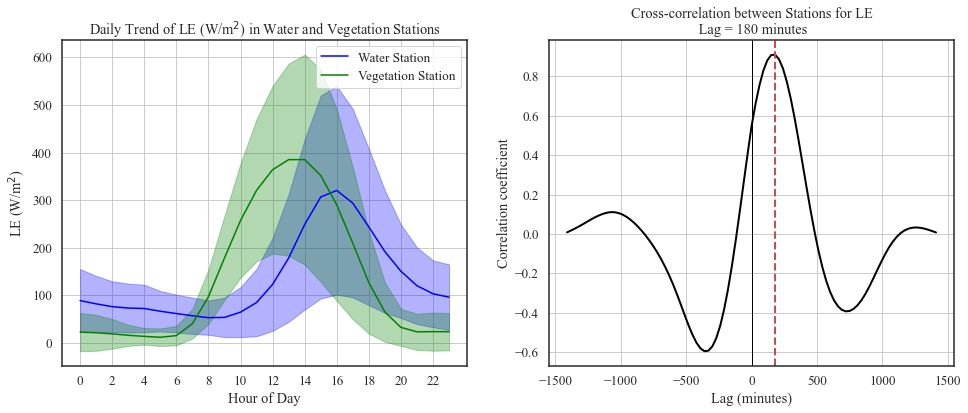

In [45]:
parameter = 'LE'
label = 'LE (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line=False)
plt.show()

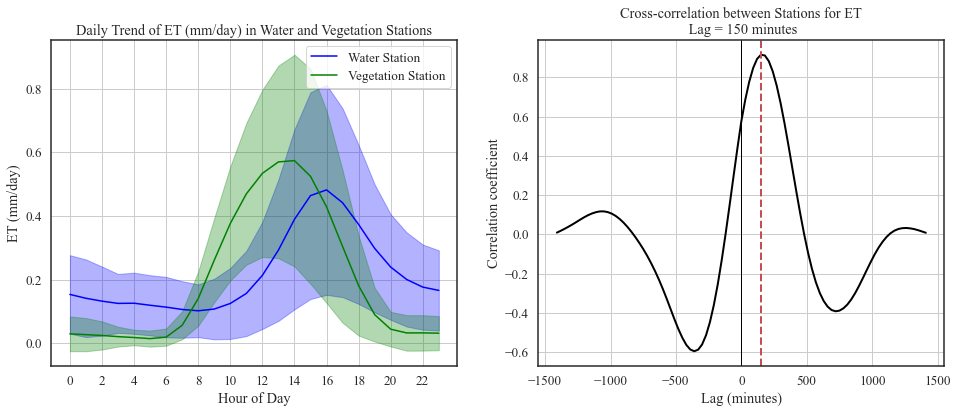

In [46]:
parameter = 'ET'
label = 'ET (mm/day)'
fig = plot_daily_trend(parameter, label, show_zero_line=False)

LE and ET represent the latent heat flux and evapotranspiration, respectively.

*As we can observe, the daily trends of these parameters exhibit a strong correlation, with a time lag of approximately 2.5 hours.* 🕰️

This lag indicates that the **latent heat flux** and **evapotranspiration** values at the **water station** are slightly delayed compared to the **vegetation station**. This can be explained by the following factors:

1. **Water heat capacity**: Water has a higher heat capacity than vegetation, meaning it takes more energy to change the temperature of water compared to vegetation and evaporate water from the surface. 
2. **Stomatal sensitivity**: The stomata of the vegetation are more sensitive to environmental conditions, such as radiation, leading to a faster response in evapotranspiration.

Interestingly, the **amplitude** of the latent heat flux and evapotranspiration values is **equivalent between the two stations**, suggesting that the vegetation has **no water stress** during the observed period. This makes sense, as the data is from an island in the middle of the lake, where water availability is likely not a limiting factor. 🌱💧

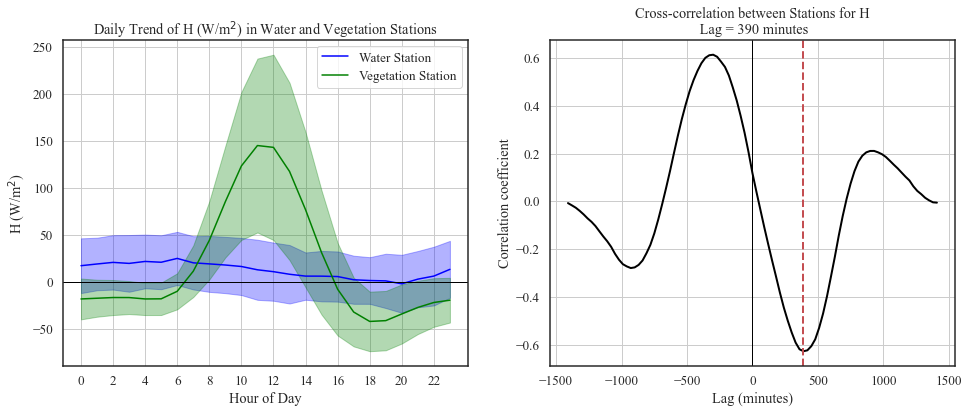

In [47]:
parameter = 'H'
label = 'H (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line=True)

In [48]:
# Calculate the mean daily H for each of the stations:
veg_h_mean = veg_df['H'].resample('D').mean().mean()
water_h_mean = water_df['H'].resample('D').mean().mean()

# Calculate the STD daily H for each of the stations:
veg_h_std = veg_df['H'].resample('D').std().mean()
water_h_std = water_df['H'].resample('D').std().mean()

# Print the mean+- std daily H for each of the stations:
print(f"Mean daily H in vegetation station: {veg_h_mean:.1f} +- {veg_h_std:.1f}")
print(f"Mean daily H in water station: {water_h_mean:.1f} +- {water_h_std:.1f}")

Mean daily H in vegetation station: 17.9 +- 66.9
Mean daily H in water station: 11.7 +- 23.8


Sensible heat flux (H) represent the transfer of heat from the surface to the air layer. 🌡️

Similar to the previous observations, there is a **time lag** between the **water station** and the **vegetation station**, although in this case, the **difference in amplitude** appears to be more significant. 📈

While the **daily average** of H is relatively similar between the two stations (17 and 11 W/m$^2$ for vegetation and water station, respectively), the **standard deviation** at the **vegetation station** is **~3 times higher**. 

This trend is clearly observed in the graph:

- The H values at the **water station** remain **relatively constant**. 
- In contrast, the **vegetation station** exhibits a **clear daily trend**, with an **increase during the day** and a **decrease during the night**, even reaching **negative values** (indicating a negative temperature difference between the air and the ground). 🌇

These phenomena can be explained by the physical differences between the two environments:

1. **Water heat capacity**: Water has a higher heat capacity, which leads to a more **gradual and muted response** to changes in environmental conditions.
2. **Vegetation heat capacity**: Vegetation has a lower heat capacity, allowing it to **respond more quickly** to climatic and environmental changes. 🌱

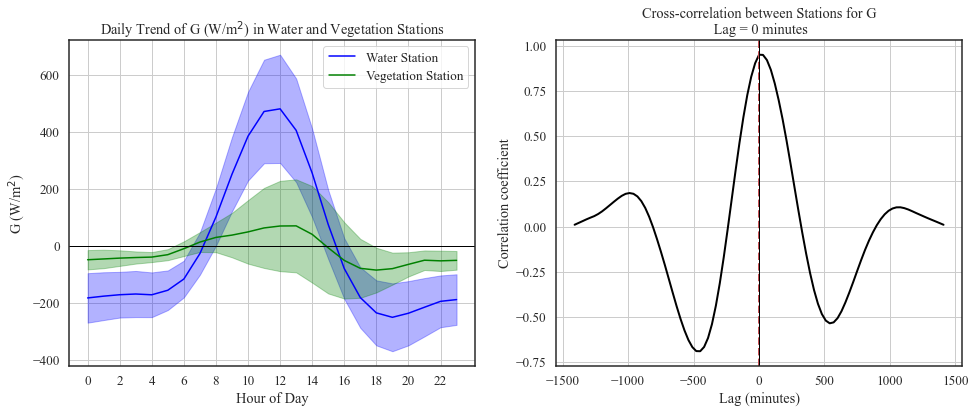

In [49]:
parameter = 'G'
label = 'G (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line=True)

**Daily Trend of G (Soil Heat Flux):**
  - The **water station** exhibits a relatively **stable and muted daily trend** of G, with **smaller fluctuations**.
  - The **vegetation station** shows a **more pronounced daily trend**, with a **clear increase in G during the day** and a **decrease at night**, even **reaching negative values**.

**Amplitude Difference:**
  - The **amplitude** (range) of G is **larger at the vegetation station** compared to the water station.

**Time Lag:**
  - There is a **time lag of half hour** between the peak values of G at the water station and the vegetation station.

The differences in the behavior of G between the water and vegetation stations can be explained by the contrasting physical properties of the two environments:

Here, also the time lag is observed, with the vegetation station experiencing changes in G slightly earlier than the water station. This can be attributed to the faster response of vegetation to environmental conditions, leading to a more pronounced daily cycle in G. 🌿🌡️

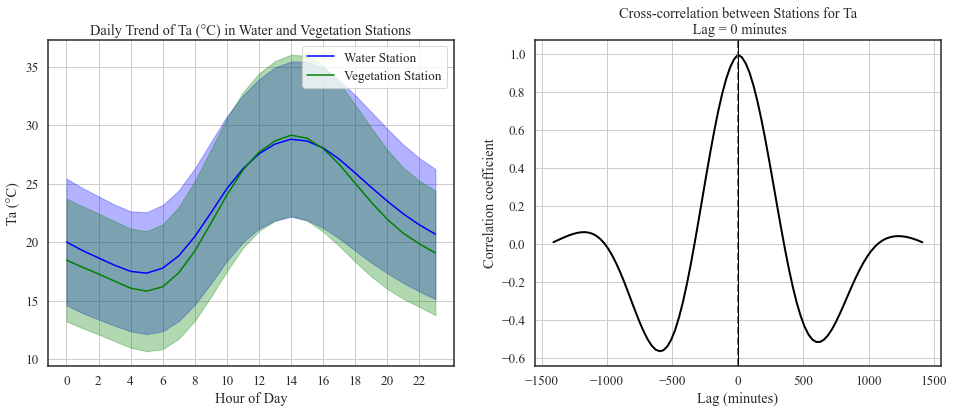

In [50]:
parameter = 'Ta'
label = 'Ta (°C)'
fig = plot_daily_trend(parameter, label, show_zero_line = False)

Let's check the temerture differences between the stations using T-test to see if the differences are significant:

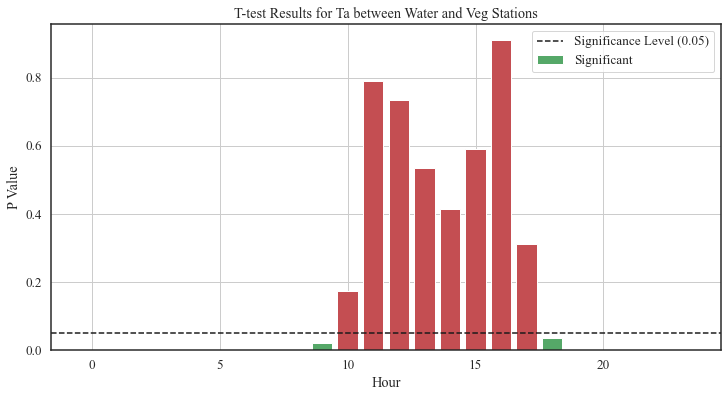

In [51]:
# Calculate the t test for the 2 stations Ta in every hour of the day
t_test_results = []

# Loop through each hour of the day
for hour in range(24):
    # Filter the data for the specific hour
    water_hour = water_df[water_df.index.hour == hour]['Ta']
    veg_hour = veg_df[veg_df.index.hour == hour]['Ta']
    
    # Perform the t test
    t_stat, p_val = stats.ttest_ind(water_hour, veg_hour, equal_var=False)
    
    # Append the results to the list
    t_test_results.append((hour, t_stat, p_val))

# Create a dataframe from the list
t_test_df = pd.DataFrame(t_test_results, columns=['Hour', 'T Statistic', 'P Value'])

t_test_df['Is Significant'] = t_test_df['P Value'] < 0.05

# Plot the results
fig, ax = plt.subplots(figsize=(12, 6))
ax.bar(t_test_df['Hour'], t_test_df['P Value'], color=t_test_df['Is Significant'].map({True: 'g', False: 'r'}))
ax.set_xlabel('Hour')
ax.set_ylabel('P Value')
ax.set_title('T-test Results for Ta between Water and Veg Stations')
ax.axhline(y=0.05, color='k', linestyle='--')
ax.grid(True)
ax.legend(['Significance Level (0.05)', 'Significant', 'Not Significant'], loc='upper right')
plt.show()

**Daily Trend of Ta:**
- The **2 stations exhibit a similar daily trend in Ta**, with a peak around midday and a minimum during the night.
- There is no time lag between the 2 stations, as the cross-correlation plot shows a strong positive correlation at lag 0.
- From the t-test, we can see that **the difference in Ta between the 2 stations is statistically significant (p-value < 0.05) during night until morning (10:00 AM)**, with the vegetation station having lower temperatures compared to the water station. This difference can be attributed to the heat capacity of water, which leads to more stable temperatures compared to the vegetation station. 🌡️🌿

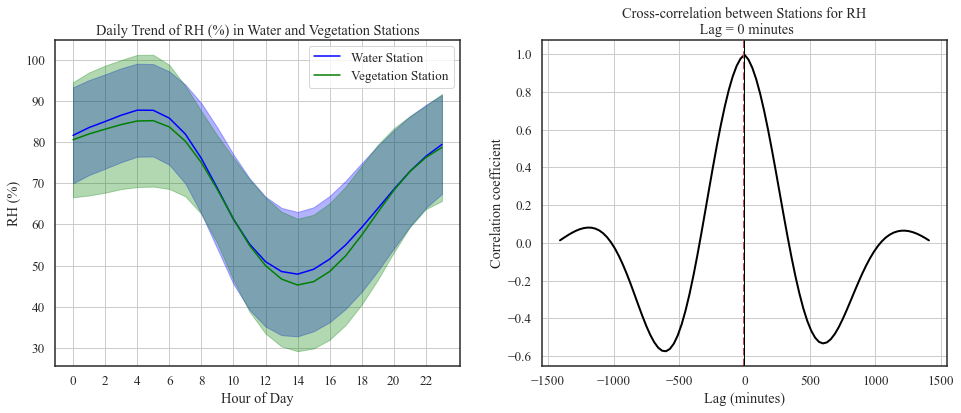

In [52]:
parameter = 'RH'
label = 'RH (%)'
fig = plot_daily_trend(parameter, label, show_zero_line = False)

As expected, the RH exhibits an inverse relationship with temperature, with higher RH values observed during the night and early morning when temperatures are lower. The daily trend of RH is relatively consistent between the two stations, with both showing a peak in RH during the night and a decrease during the day. The time lag between the two stations is 0, indicating that the RH values are synchronized. 🌡️💧

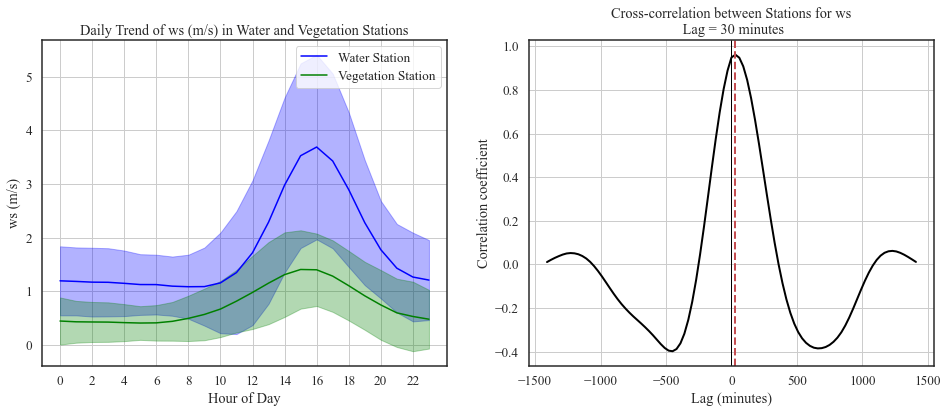

In [53]:
parameter = 'ws'
label = 'ws (m/s)'
fig = plot_daily_trend(parameter, label, show_zero_line = False)

**Daily Trend of Wind Speed:**

1. **Daily Trend of ws:**
  - The **vegetation station** exhibits a relatively **smooth and muted daily trend** of ws, with **smaller fluctuations**.
  - The **water station** shows a **more pronounced daily trend**, with a **clear increase in ws during the day** and a **decrease at night**.

2. **Amplitude Difference:**
  - The **amplitude** (range) of ws is **larger at the water station** compared to the vegetation station.

3. **Time Lag:**
  - There is a **time lag of approximately 30 minutes** between the peak values of ws at the water station and the vegetation station.

The differences in the behavior of ws between the water and vegetation stations can be explained by:

- **Surface roughness:** The **vegetation station** has a **higher surface roughness** compared to the **water station**, which can lead to more turbulence and fluctuations in wind speed.
- **Wind sheltering:** The presence of vegetation can **shield the wind**, leading to lower wind speeds compared to the open water surface.


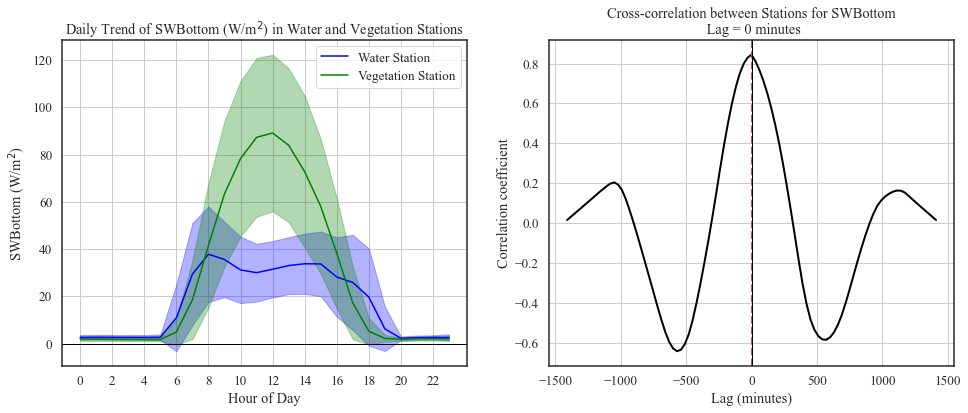

In [54]:
parameter = 'SWBottom'
label = 'SWBottom (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line = True)

*SWBottom* is the shortwave radiation reflected from the surface towards the sky.

1. **Daily Trend of SWBottom:**
  - The **vegetation station** exhibits a **more pronounced daily trend** in SWBottom, with **higher amplitude** compared to the **water station**.
  - The **water station** shows an increase in SWBottom during the morning, constant values during the day, and a decrease in the evening.
2. **Amplitude Difference:**
  - The **amplitude** of SWBottom is **higher at the vegetation station** compared to the water station.


The differences in the behavior of SWBottom between the water and vegetation stations can be explained by the contrasting physical properties of the two environments. The water absorbs more solar radiation compared to vegetation, leading to a more stable and consistent trend in SWBottom at the water station and less reflection towards the sky. 🌞🌿

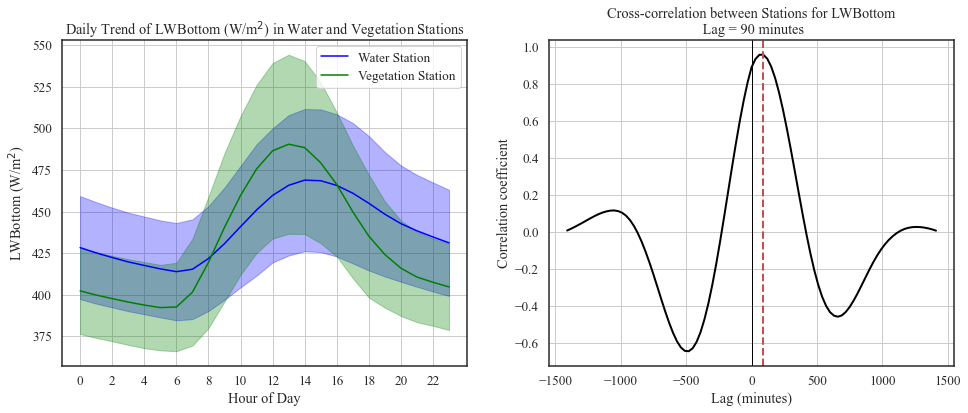

In [55]:
parameter = 'LWBottom'
label = 'LWBottom (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line = False)



1. **Daily Trend of LWBottom (longwave radiation from the bottom up):**
  - The **water station** exhibits a relatively **smooth and muted daily trend** of LWBottom, with **smaller fluctuations**.
  - The **vegetation station** shows a **more pronounced daily trend**, with a **clear increase in LWBottom during the day** and a **decrease at night**.

2. **Amplitude Difference:**
  - The **amplitude** (range) of LWBottom is **larger at the vegetation station** compared to the water station.

3. **Time Lag:**
  - There is a **time lag of approximately 90 minutes** between the peak values of LWBottom at the water station and the vegetation station.

The differences in the behavior of LWBottom between the water and vegetation stations can be explained by the following factors:

- **Thermal properties:** The **water station** exhibits a more stable trend in LWBottom due to the higher heat capacity of water, which leads to slower changes in longwave radiation.
- **Vegetation response:** The **vegetation station** shows a more dynamic trend in LWBottom, reflecting the rapid changes in longwave radiation associated with vegetation properties and environmental conditions.
- 

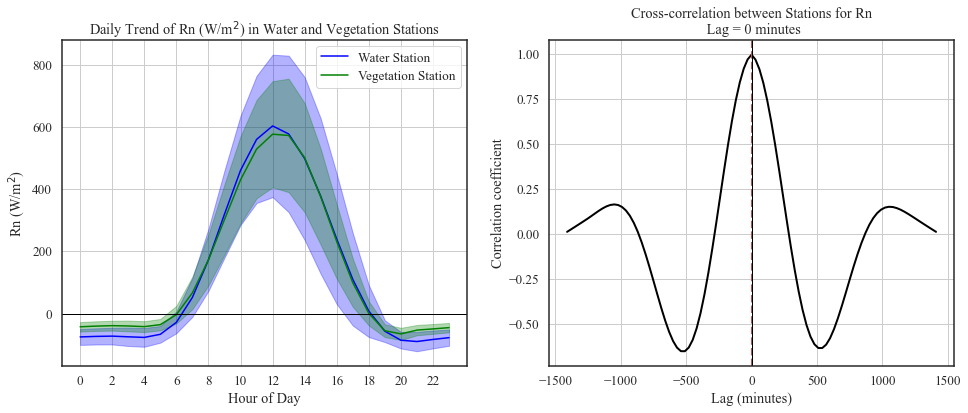

In [56]:
parameter = 'Rn'
label = 'Rn (W/m$^2$)'
fig = plot_daily_trend(parameter, label, show_zero_line=True)

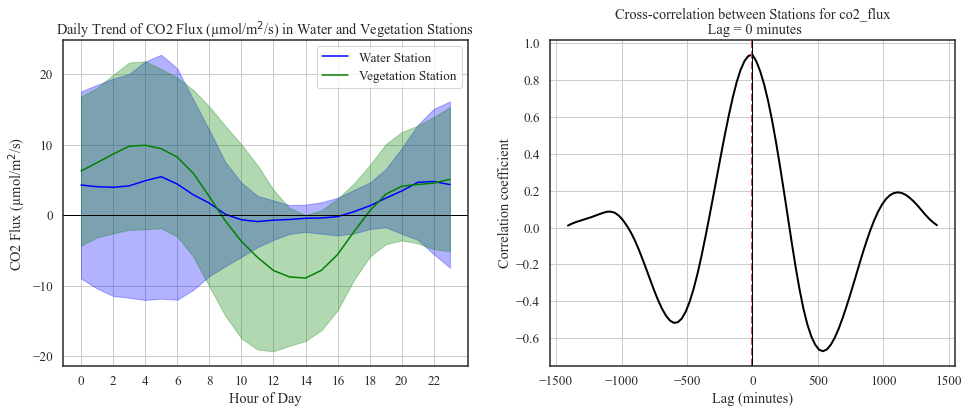

In [57]:
parameter = 'co2_flux'
label = 'CO2 Flux (µmol/m$^2$/s)'
fig = plot_daily_trend(parameter, label, show_zero_line = True)

The daily trend graphs reveal some interesting insights into the carbon flux dynamics between the water and vegetation stations:

**Vegetation Station**:
- The daily trend clearly shows a pattern of **carbon fixation during the day** (negative values) due to photosynthesis, and **carbon emission at night** (positive values) due to respiration.
- However, the **overall carbon sequestration should be significantly higher than the emission**, given the assumption that wetlands are important carbon sinks.
- The observed trend requires further research to understand the underlying factors. **Dividing the data into specific periods and examining it in more detail** could provide additional insights.
- Evaluating the **microbial content of the soil** can also help in understanding the carbon dynamics at the vegetation station, as the soil microbiome can significantly influence the carbon dynamics.

**Water Station**:
- The situation is more complex for the water station, as it involves a mix of carbon sources and sinks, such as animals, secretions, plants, and algae.
- The **more muted daily trend** observed at the water station suggests a **more balanced carbon budget**, with both fixation and emission processes occurring.
- Determining the **net carbon flux** and understanding the **relative contributions of the different components** (e.g., aquatic biota, water-air exchange) would require a more in-depth analysis.

CO<sub>2</sub> flux is central to my research focus, and a **more comprehensive investigation would be valuable**.
**Dividing the data into specific periods**, examining **seasonal variations**, and incorporating **additional factors** (e.g., soil microbiome, aquatic biota) could provide a more nuanced understanding of the carbon dynamics at the two stations.

Exploring the **underlying mechanisms and drivers** of the observed trends, as well as **quantifying the net carbon sequestration or emission**, would be important next steps (but beyond the scope of this analysis).

# Long Term Analysis

1. Read the NDVI data of Sentinel-2 for both stations. 
   - The data contains the NDVI values for the water station and the vegetation station over the period from 2017 to 2024. Every point in each time series represents the average NDVI value over a 5-day period (temporal resolution) and the mean NDVI of a poligon of the area of the station (spatial resolution).
   - The data downloaded from the Sentinel-2 satellite, which provides relatively high-resolution optical images of the Earth's surface.
   - NDVI (normalized difference vegetation index) is a widely-used metric for quantifying the health and density of vegetation using sensor data. It is calculated from spectrometric data at two specific bands: red and near-infrared by the following formula:
  $$ NDVI = \frac{NIR - RED}{NIR + RED} $$

2. Explore the distribution of NDVI values for both stations.
   
3. Smoothing the NDVI data using rolling mean with a window size of 7.

4. Resample the NDVI to weekly and interpolate using linear interpolation the missing values.

5. Decompose the NDVI time series into trend, seasonal, and residual components in order to observe the yearly and long-term dynamics of vegetation at the two stations.

6. **Stationarity Test**: Perform the Augmented Dickey-Fuller test to check the stationarity of the NDVI time series for both stations.

7. **PACF and ACF**: Plot the Partial Autocorrelation Function (PACF) and Autocorrelation Function (ACF) of the NDVI time series for both stations.

8. **ARIMA Model**: Fit an ARIMA model to the NDVI time series for both stations and make predictions for the last 2 years.

In [58]:
# Function to read the NDVI data
def read_ndvi(path):
    ndvi_df = pd.read_csv(path, index_col=0, parse_dates=True)
    ndvi_df. columns = ['min', 'max', 'mean', 'stDev', 'sampleCount',
        'noDataCount', 'median', 'C0/p10', 'C0/p90',
        'C0/cloudCoveragePercent']

    # change the index formt from 2022-09-02 00:00:00+00:00 to 2022-09-02
    ndvi_df.index = ndvi_df.index.date

    # convert the index to datetime
    ndvi_df.index = pd.to_datetime(ndvi_df.index)

    # keep relevant columns
    ndvi_df = ndvi_df[['mean','stDev','median']]

    return ndvi_df

1. Read the NDVI data of Sentinel-2 for both stations. 

In [59]:
ndvi_water_path = r'Water_NDVI.csv'
ndvi_veg_path = r'Veg_NDVI.csv'

ndvi_veg = read_ndvi(ndvi_veg_path)
ndvi_water = read_ndvi(ndvi_water_path)

ndvi_veg.head(), ndvi_water.head()

(                mean     stDev    median
 2019-03-17  0.550008  0.092096  0.551328
 2019-03-22  0.572053  0.108010  0.574267
 2019-04-01  0.016343  0.004140  0.016280
 2019-04-11  0.696281  0.109822  0.704599
 2019-04-26  0.698698  0.076665  0.708532,
                 mean     stDev    median
 2019-03-17  0.250715  0.302253  0.020243
 2019-03-22  0.210842  0.364012 -0.044369
 2019-04-11  0.542184  0.214659  0.587719
 2019-05-01  0.520394  0.270051  0.465288
 2019-05-11  0.196254  0.649867  0.175325)

2. Explore the distribution of NDVI values for both stations.

Text(0.5, 1.02, 'Pairplot of NDVI for Vegetation Station')

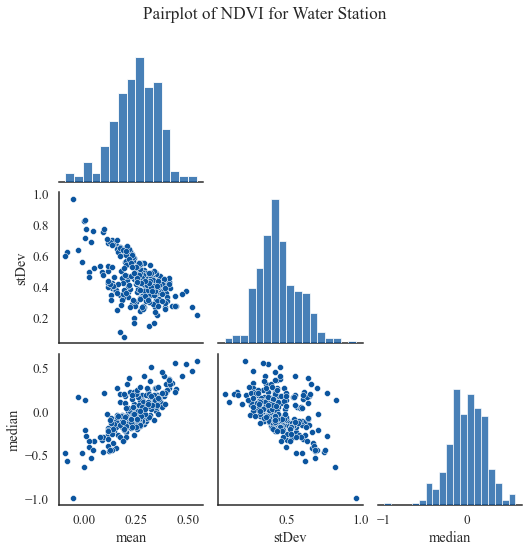

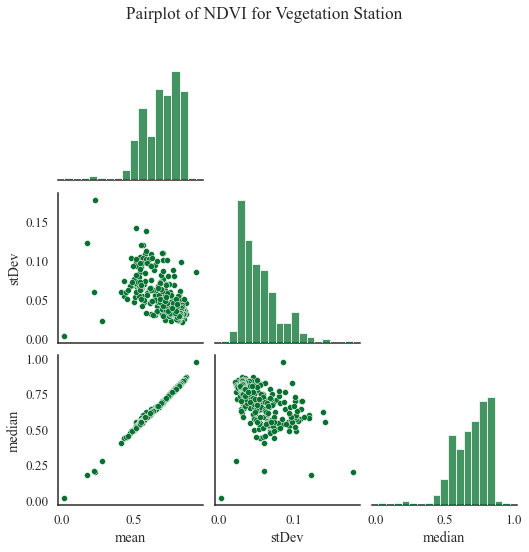

In [60]:
# Plot pairplot for water in blue
sns.set_theme(style="white",font_scale = 1.2,palette='Blues_r')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['axes.linewidth'] = 1.5
a = sns.pairplot(data = ndvi_water,corner = True)
a.fig.suptitle('Pairplot of NDVI for Water Station', y=1.02)

# Plot pairplot for veg in green
sns.set_theme(style="white",font_scale = 1.2,palette='Greens_r')
plt.rcParams['font.family'] = 'serif'
plt.rcParams['font.serif'] = ['Times New Roman'] + plt.rcParams['font.serif']
plt.rcParams['axes.linewidth'] = 1.5
b = sns.pairplot(data= ndvi_veg,corner = True)
b.fig.suptitle('Pairplot of NDVI for Vegetation Station', y=1.02)

In [61]:
# Calculate r2 of mean and median veg and water
r, p = stats.pearsonr(ndvi_veg['mean'], ndvi_veg['median'])
r2_veg = r**2

r, p = stats.pearsonr(ndvi_water['mean'], ndvi_water['median'])
r2_water = r**2

# print the r2 values
print(f"R-squared value for vegetation station: {r2_veg:.1f}")
print(f"R-squared value for water station: {r2_water:.1f}")

R-squared value for vegetation station: 1.0
R-squared value for water station: 0.6


**Insights from the NDVI Distribution:**
- As expected, the **NDVI values** for the **vegetation station** are **higher** on average compared to the **water station**, indicating **denser and vegetation** on the island.
- The NDVI values of water bodies are typically between -1 to 0. Here, the **water station** shows **NDVI values close to 0** (even positive values), which could be due to the presence of **algae, aquatic plants, or floating vegetation**.
- The correlation of mean with median is **higher for the vegetation station** (1 and 0.6 respectively), indicating a **more homogeneous distribution** of NDVI values in the vegetation area compared to the water area. This can be also shown by the distribution of standard deviation, which is higher for the water station.
- The distribution of the median NDVI values of the water station is much wider than the distribution of the mean NDVI values, indicating that the NDVI values are **skewed**. This could be due to the presence of **outliers** or **extreme values**.

3. Smoothing the NDVI data using rolling mean with a window size of 7.
4. Resample the NDVI to weekly and interpolate using linear interpolation the missing values.

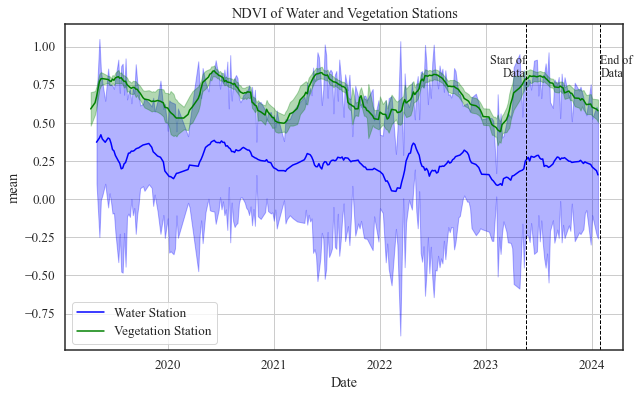

In [62]:
# Smooth the ndvi mean
ndvi_water['mean'] = ndvi_water.rolling(7,center = True).mean()
ndvi_veg['mean'] = ndvi_veg.rolling(7,center = True).mean()

# Resample the ndvi to weekly and interpolate using linear interpolation the missing values
ndvi_water_weekly = ndvi_water.resample('W').mean().interpolate(method='linear')
ndvi_veg_weekly = ndvi_veg.resample('W').mean().interpolate(method='linear')

# plot the mean + std ndvi of the 2 stations
fig, ax = plt.subplots(figsize=(10, 6))
ax.plot(ndvi_water['mean'], label='Water Station', color='blue')
ax.fill_between(ndvi_water.index, ndvi_water['mean'] - ndvi_water['stDev'], ndvi_water['mean'] + ndvi_water['stDev'], alpha=0.3, color='blue')
ax.plot(ndvi_veg['mean'], label='Vegetation Station', color='green')
ax.fill_between(ndvi_veg.index, ndvi_veg['mean'] - ndvi_veg['stDev'], ndvi_veg['mean'] + ndvi_veg['stDev'], alpha=0.3, color='green')

# Add the start and end of the veg_df
ax.axvline(veg_df.index[0], color='black', linestyle='--', lw=1)
ax.axvline(veg_df.index[-1], color='black', linestyle='--', lw=1)
# Add text for the start and end of the veg_df
ax.text(veg_df.index[0], 0.8, 'Start of\nData', fontsize=12, ha='right')
ax.text(veg_df.index[-1], 0.8, 'End of\nData', fontsize=12, ha='left')

ax.set_xlabel('Date')
ax.set_ylabel('mean')
ax.set_title('NDVI of Water and Vegetation Stations')
ax.legend()
ax.grid(True)
plt.show()

In [63]:
# Drop nan values to perform the correlation
ndvi_water_weekly = ndvi_water_weekly.dropna(subset=['mean'])
ndvi_veg_weekly = ndvi_veg_weekly.dropna(subset=['mean'])

5. Decompose the NDVI time series into trend, seasonal, and residual components in order to observe the yearly and long-term dynamics of vegetation at the two stations.

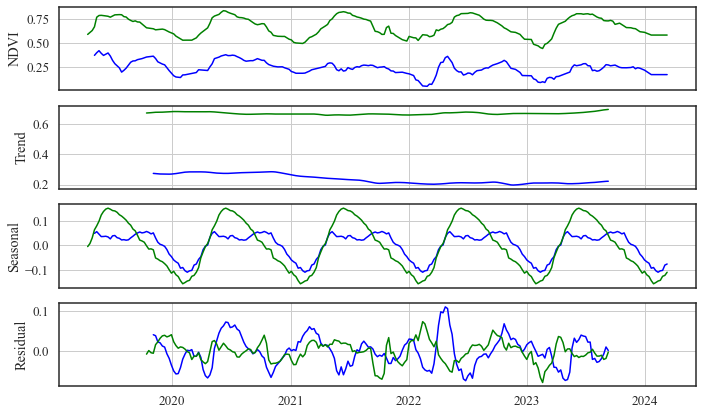

In [64]:
# decompose the NDVI of the 2 stations
water_decomp = seasonal_decompose(ndvi_water_weekly['mean'], model='additive', period=52)
veg_decomp = seasonal_decompose(ndvi_veg_weekly['mean'], model='additive', period=52)

# plot the trend + seasonal +noise of the 2 stations in different subplots 
fig, axes = plt.subplots(4, 1, figsize=(10, 6), sharex=True)

# plot the trend
axes[1].plot(water_decomp.trend, label='Water Station', color='blue')
axes[1].plot(veg_decomp.trend, label='Vegetation Station', color='green')
axes[1].set_ylabel('Trend')
axes[1].grid(True)

# plot the seasonal
axes[2].plot(water_decomp.seasonal, label='Water Station', color='blue')
axes[2].plot(veg_decomp.seasonal, label='Vegetation Station', color='green')
axes[2].set_ylabel('Seasonal')
axes[2].grid(True)

# plot the noise
axes[3].plot(water_decomp.resid, label='Water Station', color='blue')
axes[3].plot(veg_decomp.resid, label='Vegetation Station', color='green')
axes[3].set_ylabel('Residual')
axes[3].grid(True)

# plot the NDVI IN DIFFERENT AXIS
axes[0].plot(ndvi_water_weekly['mean'], label='Water Station', color='blue')
axes[0].plot(ndvi_veg_weekly['mean'], label='Vegetation Station', color='green')
axes[0].set_ylabel('NDVI')
axes[0].grid(True)

plt.tight_layout()
plt.show()


# focus on the seasonal 
# take just 2020 data in the seasonal component
seasonal_water = water_decomp.seasonal['2020']
seasonal_veg = veg_decomp.seasonal['2020']


From the decomposition of the NDVI time series, we can observe the following trends:
- There is no significant trend in the NDVI values for the vegetation station, indicating **relatively stable vegetation dynamics** over the years. Water station presents a slight decrease in the trend between 2020 to 2021.
- The seasonal component shows a clear **annual cycle** for vegetation, with **higher NDVI values** during the **spring and summer months** and **lower values** during the **fall and winter months**. This pattern is consistent with the **seasonal growth and dormancy** of vegetation. 
- The seasonal component of the water station is interesting, st seems that there is 2 peaks in the NDVI values, one in the spring before the peak of vegetation, and one between August to December. Let's investigate this further by plotting the seasonal component of the NDVI values for the water station. of one year in addition to the Bird migration season, which occures in the fall between [this months](https://www.google.com/search?q=%D7%A2%D7%95%D7%A0%D7%AA+%D7%94%D7%A0%D7%93%D7%99%D7%93%D7%94+%D7%90%D7%92%D7%9E%D7%95%D7%9F+%D7%94%D7%97%D7%95%D7%9C%D7%94&sca_esv=2465539c7fa84006&sxsrf=ACQVn0-LqBRhqYJBvQJaOfXSuHo5x-NDsg%3A1712771835461&ei=-9IWZpWeG-2rkdUPiOmwqAI&udm=&oq=%D7%A2%D7%95%D7%A0%D7%AA+%D7%94%D7%A0%D7%93%D7%99%D7%93%D7%94&gs_lp=Egxnd3Mtd2l6LXNlcnAiFdei15XXoNeqINeU16DXk9eZ15PXlCoCCAIyBRAAGIAEMgUQABiABDIFEAAYgAQyBRAuGIAEMgUQABiABDIGEAAYFhgeMgYQABgWGB4yBhAAGBYYHjIGEAAYFhgeMgYQABgWGB5IgyBQAFiUEHAAeAGQAQCYAZUCoAHrD6oBBTAuOC4zuAEDyAEA-AEBmAILoAKLEcICDhAuGIAEGIoFGLEDGIMBwgIOEC4YgwEYsQMYgAQYigXCAhEQLhiABBixAxjHARivARiOBcICCxAAGIAEGLEDGIMBwgIREC4YgAQYsQMYgwEYxwEY0QPCAg4QABiABBiKBRixAxiDAcICCxAuGIAEGLEDGIMBwgIdEC4YgAQYigUYsQMYgwEYlwUY3AQY3gQY4ATYAQHCAggQABiABBixA8ICCBAuGIAEGLEDwgIgEC4YgAQYsQMYxwEYrwEYjgUYlwUY3AQY3gQY4ATYAQHCAgQQABgDmAMAugYGCAEQARgUkgcHMC44LjIuMaAHxIkB&sclient=gws-wiz-serp):

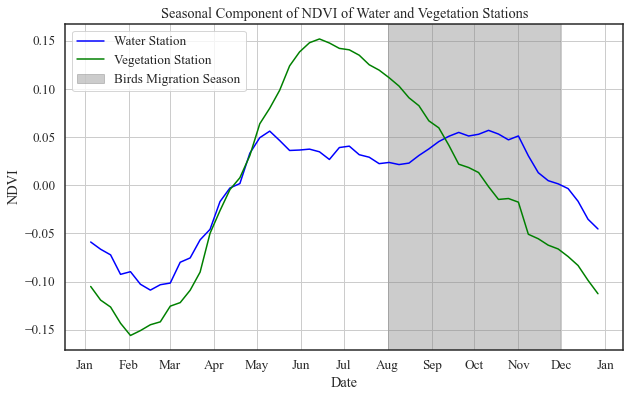

In [65]:
# plot only the Seasonal component of the 2 stations at 2023
fig, ax = plt.subplots(figsize=(10, 6))

# plot the seasonal component
ax.plot(seasonal_water, label='Water Station', color='blue')
ax.plot(seasonal_veg, label='Vegetation Station', color='green')

ax.set_xlabel('Date')
ax.set_ylabel('NDVI')
# set ticks at x axis in months
ax.xaxis.set_major_locator(mdates.MonthLocator())
ax.xaxis.set_major_formatter(mdates.DateFormatter('%b'))

ax.set_title('Seasonal Component of NDVI of Water and Vegetation Stations')

# Add gray background for October to December for the plot
ax.axvspan('2020-08-01', '2020-11-30', color='gray', alpha=0.4, label='Birds Migration Season')

ax.legend()
ax.grid(True)
plt.show()

The observed data suggests that the **second peak in NDVI coincides with the bird migration season**. This observation leads to the following hypothesis:

If it were not for the bird migration, we would expect a **decrease in NDVI values** after the initial increase in the spring. However, the persistence of the peak at the vegetation station compared to the water station may be explained by the **specific vegetation type** in the area.

If this hypothesis is correct, it implies that the **presence of migratory birds increases the amount of vegetation in the lake during the migration period**. This could potentially be due to the **enrichment of the water with nutrients** from the birds' activities, such as excrement or foraging.

Further research is needed to:
1. **Confirm the correlation between the NDVI peak and the bird migration season**.
2. **Investigate the mechanisms by which the birds' presence leads to increased vegetation**, such as nutrient input or other ecological interactions.
3. **Explore the differences in vegetation type and phenology between the water and vegetation stations** that may contribute to the observed patterns.


6. **Stationarity Test**: Perform the Augmented Dickey-Fuller test to check the stationarity of the NDVI time series for both stations.



In [66]:
def check_stationarity(df, column):
    """
    Checks the stationarity of a column in a pandas DataFrame using the Augmented Dickey-Fuller (ADF) test.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame.
    column (str): The name of the column to check for stationarity.
    
    Returns:
    dict: A dictionary containing the ADF test results.
    """

    # Perform the Augmented Dickey-Fuller test
    adf_result = adfuller(df[column].dropna(), autolag='AIC')
    
    # Create a dictionary to store the ADF test results
    adf_dict = {
        'ADF Statistic': adf_result[0],
        'p-value': adf_result[1],
        'Number of Lags Used': adf_result[2],
        'Number of Observations': adf_result[3],
        'Critical Values': adf_result[4]
    }
    
    print(f"Augmented Dickey-Fuller Test for '{column}':")
    print('---' * 20)
    print(adf_dict)
    print('---' * 20)
    
    if adf_dict['p-value'] < 0.05:
        print(f"The series '{column}' is stationary.")
    else:
        print(f"The series '{column}' is non-stationary.")
    
    return adf_dict

In [67]:
# Use the function to check the stationarity of the NDVI for the water station
check_stationarity(ndvi_water_weekly, 'mean')

Augmented Dickey-Fuller Test for 'mean':
------------------------------------------------------------
{'ADF Statistic': -4.611579689948705, 'p-value': 0.00012296829787201847, 'Number of Lags Used': 3, 'Number of Observations': 250, 'Critical Values': {'1%': -3.456780859712, '5%': -2.8731715065600003, '10%': -2.572968544}}
------------------------------------------------------------
The series 'mean' is stationary.


{'ADF Statistic': -4.611579689948705,
 'p-value': 0.00012296829787201847,
 'Number of Lags Used': 3,
 'Number of Observations': 250,
 'Critical Values': {'1%': -3.456780859712,
  '5%': -2.8731715065600003,
  '10%': -2.572968544}}

In [68]:
# Use the function to check the stationarity of the NDVI for the vegetation station
check_stationarity(ndvi_veg_weekly, 'mean')

Augmented Dickey-Fuller Test for 'mean':
------------------------------------------------------------
{'ADF Statistic': -5.88093818787042, 'p-value': 3.0795868172633154e-07, 'Number of Lags Used': 12, 'Number of Observations': 244, 'Critical Values': {'1%': -3.457437824930831, '5%': -2.873459364726563, '10%': -2.573122099570008}}
------------------------------------------------------------
The series 'mean' is stationary.


{'ADF Statistic': -5.88093818787042,
 'p-value': 3.0795868172633154e-07,
 'Number of Lags Used': 12,
 'Number of Observations': 244,
 'Critical Values': {'1%': -3.457437824930831,
  '5%': -2.873459364726563,
  '10%': -2.573122099570008}}

The results of the Augmented Dickey-Fuller test indicate that the NDVI time series for both the water and vegetation stations are **stationary**. This suggests that the time series data does not exhibit a trend or systematic pattern over time, as we see in the decomposition analysis.

7. **PACF and ACF**: Plot the Partial Autocorrelation Function (PACF) and Autocorrelation Function (ACF) of the NDVI time series for both stations.


In [69]:
def plot_pacf_acf(df_water,df_veg, lag=40):
    """
    Plots the Partial Autocorrelation Function (PACF) and Autocorrelation Function (ACF)
    for the NDVI time series of both the water and vegetation stations.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame containing the NDVI data.
    'mean' (str): The name of the column containing the water station NDVI data.
    veg_col (str): The name of the column containing the vegetation station NDVI data.
    lag (int): The number of lags to display in the plots (default is 40).
    """
    fig, axes = plt.subplots(2, 2, figsize=(12, 8))

    # Set sns palette to Blues
    sns.set_palette('Blues_r')
    
    # Water station PACF and ACF
    plot_pacf(df_water['mean'], ax=axes[0, 0], lags=lag, color='blue')
    axes[0, 0].set_title("Water Station PACF")

    
    plot_acf(df_water['mean'], ax=axes[0, 1], lags=lag, color='blue')
    axes[0, 1].set_title("Water Station ACF")

    # Set sns palette to Green
    sns.set_palette('Greens_r')
    
    # Vegetation station PACF and ACF
    plot_pacf(df_veg['mean'], ax=axes[1, 0], lags=lag, color='green')
    axes[1, 0].set_title("Vegetation Station PACF")
    
    plot_acf(df_veg['mean'], ax=axes[1, 1], lags=lag, color='green')
    axes[1, 1].set_title("Vegetation Station ACF")
    
    plt.suptitle("PACF and ACF Plots for NDVI Time Series")
    plt.tight_layout()
    plt.show()

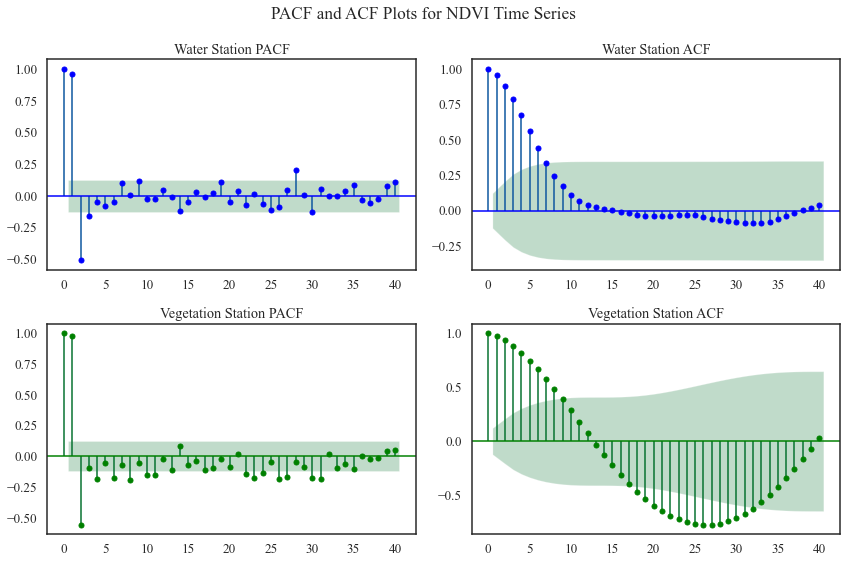

In [70]:
# plot the PACF and ACF for the NDVI of the 2 stations
plot_pacf_acf(ndvi_water_weekly, ndvi_veg_weekly, lag=40)

**1. Water Station:**
- **PACF:** The PACF plot for the water station shows significant spikes at lags 1, 2, and 3, indicating the potential presence of an autoregressive (AR) component in the time series (order 2).
  
- **ACF:** The ACF plot for the water station exhibits a gradual decay, suggesting the possible presence of a moving average (MA) component in the time series.

**2. Vegetation Station:**
- **PACF:** The PACF plot for the vegetation station shows a more complex pattern, with multiple significant spikes at various lags. This suggests the potential need for an order 2.
  
- **ACF:** The ACF plot for the vegetation station also exhibits a gradual decay, similar to the water station, implying the presence of a moving average (MA) component.

8. **ARIMA Model**: Fit an ARIMA model to the NDVI time series for both stations and make predictions for the last 2 years.

In [86]:
def plot_arima_prediction(df, color):
  """
  Fits an ARIMA model to the training data, makes predictions for the test data,
  and plots the entire time series and the predicted values with a formatted graph.
  
  Parameters:
  df (pandas.DataFrame): The input DataFrame.
  color (str): The color to use for the plot.
  
  Returns:
  The RMSE of the ARIMA model.
  """
  # Split into train and test sets
  series = df['mean']
  X = series.values 
  size = int(len(X) * 0.66) 
  train, test = X[0:size], X[size:len(X)]

  # Fit the ARIMA model on the training data
  model = ARIMA(train, order=(2,2,2))
  #model_fit = model.fit()

  # Try different estimation methods and initial parameter values
  try:
      # Try using the 'innovations_mle' method with the default start_params
      res = model.fit(method='innovations_mle')
      print(res.summary())
  except:
      try:
          # Try using the 'statespace' method with custom start_params
          start_params = [0.5, 0.5, 0.5, 0.5, 0.5, 0.5]
          res = model.fit(start_params=start_params, method='statespace')
          print(res.summary())
      except:
          try:
              # Try using the 'hannan_rissanen' method
              res = model.fit(method='hannan_rissanen')
              print(res.summary())
          except:
              print("All estimation methods failed to converge.")

  # Make predictions for the test set
  predictions = res.forecast(len(test))

  # Evaluate forecasts 
  rmse = np.sqrt(mean_squared_error(test, predictions))

  # Plot the entire time series and the predicted values
  plt.figure(figsize=(8, 4))
  plt.plot(series, color=color, label='Actual',lw=3)
  plt.plot(df.index[size:], predictions, color='red', label='Predicted',lw=3)
  # Add vertical line dashed black at start
  plt.axvline(df.index[size], color='black', linestyle='--', lw=2)
  plt.title(f"ARIMA Prediction (RMSE: {rmse:.2f})")
  plt.xlabel("Time")
  plt.ylabel('NDVI')
  plt.legend(loc='upper left')
  plt.grid()
  plt.tight_layout()
  plt.show()

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\arima\model.py:374: UserWarning:

Provided `endog` series has been differenced to eliminate integration prior to parameter estimation by method "innovations_mle".



                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  167
Model:                 ARIMA(2, 2, 2)   Log Likelihood                 440.541
Date:                Mon, 15 Apr 2024   AIC                           -871.082
Time:                        17:23:28   BIC                           -855.552
Sample:                             0   HQIC                          -864.778
                                - 167                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.2755      0.310     -0.888      0.374      -0.883       0.332
ar.L2          0.4507      0.220      2.046      0.041       0.019       0.883
ma.L1         -0.1296      5.024     -0.026      0.9

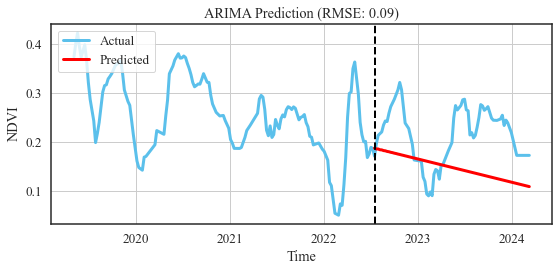

In [87]:
plot_arima_prediction(ndvi_water_weekly, '#5bc0eb')

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\arima\model.py:374: UserWarning:

Provided `endog` series has been differenced to eliminate integration prior to parameter estimation by method "innovations_mle".



                               SARIMAX Results                                
Dep. Variable:                      y   No. Observations:                  169
Model:                 ARIMA(2, 2, 2)   Log Likelihood                 429.080
Date:                Mon, 15 Apr 2024   AIC                           -848.161
Time:                        17:23:29   BIC                           -832.571
Sample:                             0   HQIC                          -841.833
                                - 169                                         
Covariance Type:                  opg                                         
                 coef    std err          z      P>|z|      [0.025      0.975]
------------------------------------------------------------------------------
ar.L1         -0.4670      0.322     -1.452      0.147      -1.098       0.163
ar.L2          0.1121      0.166      0.676      0.499      -0.213       0.437
ma.L1         -0.0488      0.319     -0.153      0.8

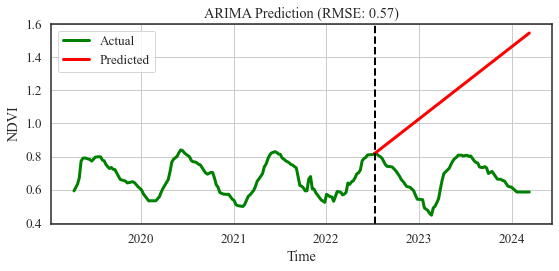

In [88]:
plot_arima_prediction(ndvi_veg_weekly, 'green')

As it can be seen from the plots, the ARIMA model fails to capture the complex dynamics of the NDVI time series for both stations. The predictions are relatively flat and do not reflect the observed patterns in the data. Lets try to predict every sample in different step. This of course is not the best way to predict the NDVI values, but it can let the model predict the values in a more accurate way.

In [89]:
def plot_arima_prediction(df, color):
    """
    Fits an ARIMA model to the first part of the given column in the DataFrame, makes a prediction for the second part,
    and plots the entire time series and the predicted values with a formatted graph.
    
    Parameters:
    df (pandas.DataFrame): The input DataFrame.
    color (str): The color to use for the plot.
    
    Returns:
    The RMSE of the ARIMA model.
    """
    # split into train and test sets
    series = df['mean']
    X = series.values 
    size = int(len(X) * 0.66) 
    train, test = X[0:size], X[size:len(X)] 

    # walk-forward validation
    history = [x for x in train] 

    # store the prediction
    predictions = list()  

    # for each time step in the test set
    for t in range(len(test)):
        # fit model and make forecast for history
        model = ARIMA(history, order=(2,2,2))
        
        # fit the model
        model_fit = model.fit() 

        # make the forecast
        output = model_fit.forecast()
        yhat = output[0]

        # store the forecast in the list of predictions
        predictions.append(yhat)
        obs = test[t] 
        history.append(obs)
    
    # evaluate forecasts 
    rmse = np.sqrt(mean_squared_error(test, predictions)) 



    # Plot the entire time series and the predicted values
    plt.figure(figsize=(8, 4))
    plt.plot(series, color=color, label='Actual',lw=3)
    plt.plot(df.index[size:], predictions, color='red', label='Predicted',lw=3)
    # Add vertical line dashed black at start
    plt.axvline(df.index[size], color='black', linestyle='--', lw=2)
    plt.title(f"ARIMA Prediction (RMSE: {rmse:.2f})")
    plt.xlabel("Time")
    plt.ylabel('NDVI')
    plt.legend(loc='upper left')
    plt.grid()
    plt.tight_layout()
    plt.show()

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals



c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\tsa\statespace\sarimax.py:966: UserWarning:

Non-stationary starting autoregressive parameters found. Using zeros a

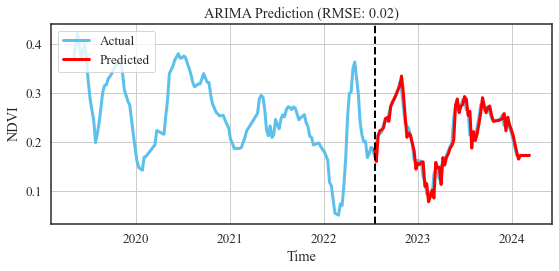

In [90]:
plot_arima_prediction(ndvi_water_weekly, '#5bc0eb')

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\ProgramData\Anaconda3\lib\site-packages\statsmodels\base\model.py:566: ConvergenceWarning:

Maximum Likelihood optimization failed to converge. Check mle_retvals

c:\P

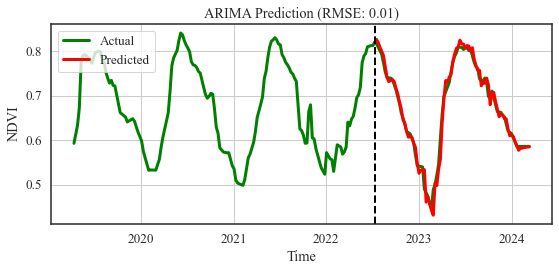

In [91]:
plot_arima_prediction(ndvi_veg_weekly, 'green')

Now the results are much better. Of course, predict on value is much easier than predict on 300 values, but the model can predict the values in a more accurate way.